In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# l2cs 패키지 설치

In [ ]:
# l2cs 패키지 설치
# !pip install git+https://github.com/edavalosanaya/L2CS-Net.git@main/

# 샘플 프레임 이미지에 l2cs yaw, pitch 추출 테스트

In [ ]:
import cv2
import torch
import numpy as np
import matplotlib.pyplot as plt
from l2cs import Pipeline, render
import os

def apply_l2cs_to_image(image_path, save_result=True, output_path=None):
    model_path = '/content/drive/MyDrive/DMS/L2CSNET/L2CSNet_gaze360.pkl'

    # 모델 가중치 파일이 없는 경우 다운로드 안내
    if not os.path.exists(model_path):
        print(f"모델 가중치 파일이 없습니다: {model_path}")
        return

    # 디바이스 설정 (GPU 또는 CPU)
    device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

    # 파이프라인 초기화
    gaze_pipeline = Pipeline(
        weights=model_path,
        arch='ResNet50',
        device=device
    )

    # 이미지 로드
    image = cv2.imread(image_path)
    if image is None:
        print(f"이미지를 로드할 수 없습니다: {image_path}")
        return

    # BGR에서 RGB로 변환 (시각화를 위해)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # 이미지 처리 및 시선 예측
    results = gaze_pipeline.step(image)

    # 결과 시각화
    output_image = render(image_rgb.copy(), results)

    # 시각화 결과 표시
    plt.figure(figsize=(12, 8))
    plt.imshow(output_image)
    plt.axis('off')
    plt.title('L2CS-Net Gaze Detection Result')
    plt.show()

    if results is not None:
        print("\n예측 결과:")

        # Pitch와 Yaw 출력
        pitch = results.pitch[0]  # pitch 값 (수직 각도)
        yaw = results.yaw[0]      # yaw 값 (수평 각도)
        print(f"  - Pitch (수직 각도): {pitch:.2f}°")
        print(f"  - Yaw (수평 각도): {yaw:.2f}°")

        # Bounding Box 출력
        bbox = results.bboxes[0]  # 얼굴 경계 상자 (x_min, y_min, x_max, y_max)
        print(f"  - Bounding Box: x_min={bbox[0]:.2f}, y_min={bbox[1]:.2f}, x_max={bbox[2]:.2f}, y_max={bbox[3]:.2f}")

        # 얼굴 랜드마크 출력
        landmarks = results.landmarks[0]  # 얼굴 랜드마크 좌표들
        print("  - Landmarks:")
        for i, landmark in enumerate(landmarks):
            print(f"      Landmark {i+1}: x={landmark[0]:.2f}, y={landmark[1]:.2f}")

        # 신뢰도 점수 출력
        score = results.scores[0]  # 얼굴 감지 신뢰도 점수
        print(f"  - Confidence Score: {score:.4f}")

        return pitch, yaw, bbox, landmarks, score
    else:
        print("얼굴이 감지되지 않았습니다.")
        return None

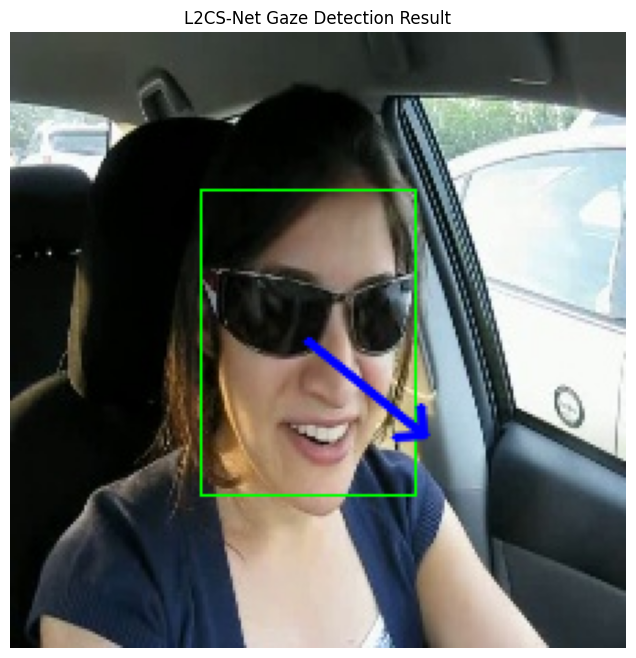


예측 결과:
  - Pitch (수직 각도): -0.64°
  - Yaw (수평 각도): -0.46°
  - Bounding Box: x_min=69.62, y_min=57.90, x_max=147.58, y_max=168.69
  - Landmarks:
      Landmark 1: x=98.33, y=99.89
      Landmark 2: x=134.03, y=101.26
      Landmark 3: x=121.00, y=126.50
      Landmark 4: x=96.94, y=139.49
      Landmark 5: x=128.01, y=140.90
  - Confidence Score: 0.9962


In [ ]:
image_path = "/content/drive/MyDrive/DMS/data/train_test_split_dataset/train_dataset/yawn_yawDD_0309/mirror15-FemaleSunGlasses-Yawning-clip-0_part3/frame000027.jpg"
apply_l2cs_to_image(image_path, save_result=False);

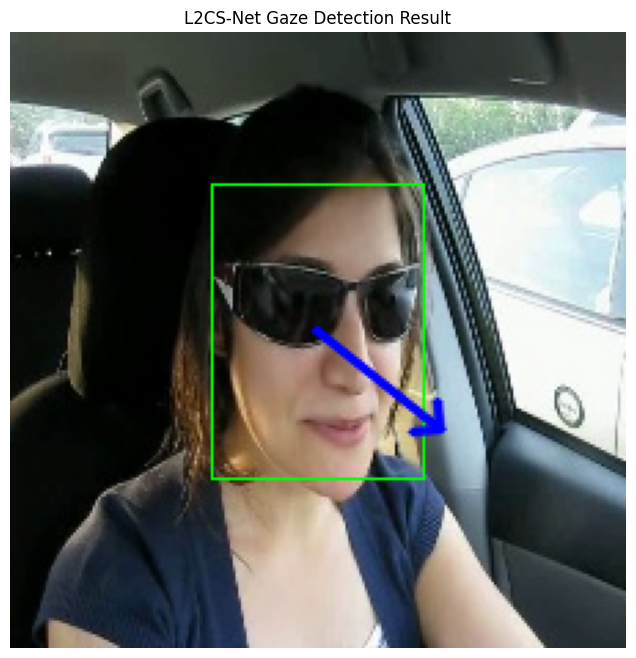


예측 결과:
  - Pitch (수직 각도): -0.72°
  - Yaw (수평 각도): -0.49°
  - Bounding Box: x_min=73.73, y_min=55.40, x_max=150.62, y_max=162.65
  - Landmarks:
      Landmark 1: x=106.02, y=96.99
      Landmark 2: x=139.17, y=96.72
      Landmark 3: x=130.67, y=121.77
      Landmark 4: x=109.07, y=139.16
      Landmark 5: x=134.13, y=139.22
  - Confidence Score: 0.9950


In [ ]:
apply_l2cs_to_image(
    '/content/drive/MyDrive/DMS/data/train_test_split_dataset/train_dataset/yawn_yawDD_0309/mirror15-FemaleSunGlasses-Yawning-clip-0_part3/frame000034.jpg',
    save_result=False);

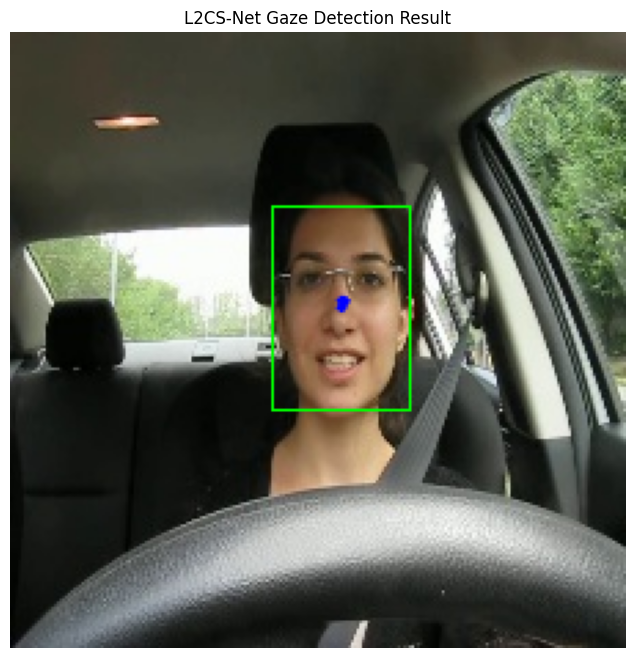


예측 결과:
  - Pitch (수직 각도): -0.03°
  - Yaw (수평 각도): 0.05°
  - Bounding Box: x_min=95.93, y_min=63.53, x_max=145.87, y_max=137.21
  - Landmarks:
      Landmark 1: x=109.33, y=89.77
      Landmark 2: x=132.97, y=89.26
      Landmark 3: x=122.13, y=107.08
      Landmark 4: x=111.75, y=118.30
      Landmark 5: x=131.95, y=117.81
  - Confidence Score: 0.9993


In [ ]:
apply_l2cs_to_image(
    '/content/drive/MyDrive/DMS/data/train_test_split_dataset/train_dataset/yawn_yawDD_0309/dash8-FemaleGlasses.avi-clip-0_part1/frame000007.jpg',
    save_result=False);

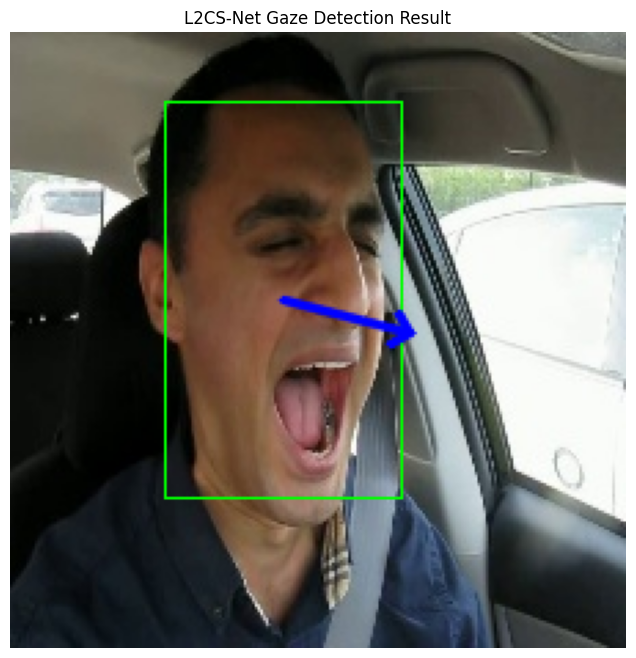


예측 결과:
  - Pitch (수직 각도): -0.57°
  - Yaw (수평 각도): -0.14°
  - Bounding Box: x_min=56.60, y_min=25.66, x_max=142.82, y_max=169.33
  - Landmarks:
      Landmark 1: x=98.46, y=74.74
      Landmark 2: x=132.72, y=76.70
      Landmark 3: x=130.47, y=97.95
      Landmark 4: x=101.66, y=126.69
      Landmark 5: x=131.85, y=128.66
  - Confidence Score: 0.9987


In [ ]:
apply_l2cs_to_image(
    '/content/drive/MyDrive/DMS/data/train_test_split_dataset/train_dataset/yawn_yawDD_0309/mirror17-MaleNoGlasses-Yawning-clip-1_part2/frame000019.jpg',
    save_result=False);

# yaw, pitch 추출

## merge_saved_csvs 함수
- output_dir 하위의 csv 들을 merge 하여 df로 반환

In [ ]:
import os

def merge_saved_csvs(output_dir):
    """
    저장된 CSV 파일들을 병합하여 하나의 DataFrame으로 반환

    Args:
        output_dir (str): 저장된 CSV 파일들이 있는 경로.

    Returns:
        pd.DataFrame: 병합된 DataFrame.
    """
    all_data = []

    for file in os.listdir(output_dir):
        if file.endswith(".csv"):
            file_path = os.path.join(output_dir, file)
            df = pd.read_csv(file_path)
            all_data.append(df)

    # 모든 데이터를 하나의 DataFrame으로 병합
    combined_df = pd.concat(all_data, ignore_index=True)

    return combined_df

## l2cs 파이프라인 설정

In [ ]:
import cv2
import torch
import numpy as np
import matplotlib.pyplot as plt
from l2cs import Pipeline, render
import os

model_path = '/content/drive/MyDrive/DMS/L2CSNET/L2CSNet_gaze360.pkl'

# 디바이스 설정 (GPU 또는 CPU)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# 파이프라인 초기화
gaze_pipeline = Pipeline(
    weights=model_path,
    arch='ResNet50',
    device=device
)

/usr/local/lib/python3.11/dist-packages/l2cs/pipeline.py:34: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(self.weights, map_location=d

## 추출

In [ ]:
def get_gaze_yaw_pitch(image_path, log=False):
    # 이미지 로드
    image = cv2.imread(image_path)
    if image is None:
        print(f"이미지를 로드할 수 없습니다: {image_path}")
        return

    try:
        # 이미지 처리 및 시선 예측
        results = gaze_pipeline.step(image)
    except Exception as e:  # 얼굴 감지 실패
        print(f"얼굴이 감지되지 않았습니다 - {image_path}")
        return None, None, None, None, None

    pitch = results.pitch[0]  # pitch 값 (수직 각도)
    yaw = results.yaw[0]      # yaw 값 (수평 각도)
    bbox = results.bboxes[0]  # 얼굴 bounding box (x_min, y_min, x_max, y_max)
    landmarks = results.landmarks[0]  # 얼굴 랜드마크 좌표들
    score = results.scores[0]  # 얼굴 감지 신뢰도 점수

    if log:
        print("\n예측 결과:")
        print(f"  - Pitch (수직 각도): {pitch:.2f}°")
        print(f"  - Yaw (수평 각도): {yaw:.2f}°")
        print(f"  - Bounding Box: x_min={bbox[0]:.2f}, y_min={bbox[1]:.2f}, x_max={bbox[2]:.2f}, y_max={bbox[3]:.2f}")
        print("  - Landmarks:")
        for i, landmark in enumerate(landmarks):
            print(f"      Landmark {i+1}: x={landmark[0]:.2f}, y={landmark[1]:.2f}")
        print(f"  - Confidence Score: {score:.4f}")


    return pitch, yaw, bbox, landmarks, score

In [ ]:
import os
import pandas as pd

def get_df(data_path, dir, log=False):
    """
    주어진 디렉토리에서 데이터를 읽어와 DataFrame을 생성합니다.

    Args:
        data_path (str): 데이터가 저장된 기본 경로.
        dir (str): 현재 처리 중인 라벨 디렉토리.
        log (bool): 로그 메시지 출력 여부.

    Returns:
        pd.DataFrame: 처리된 데이터를 포함한 DataFrame.
    """
    label = dir.split("_")[0]
    dataset = dir.split("_")[1]
    df = pd.DataFrame(columns=['label', 'video_name', 'frame', 'pitch', 'yaw', 'bbox', 'landmarks', 'score', 'dataset'])

    try:
        for video_name_dir in os.listdir(os.path.join(data_path, dir)):
            video_dir_path = os.path.join(data_path, dir, video_name_dir)
            for frame in os.listdir(video_dir_path):
                frame_path = os.path.join(video_dir_path, frame)

                # 시선 추정 결과 가져오기
                pitch, yaw, bbox, landmarks, score = get_gaze_yaw_pitch(frame_path, log)

                # 데이터 추가
                df = pd.concat([df, pd.DataFrame([{
                    'label': label,
                    'video_name': video_name_dir,
                    'frame': frame,
                    'pitch': pitch,
                    'yaw': yaw,
                    'bbox': bbox,
                    'landmarks': landmarks,
                    'score': score,
                    'dataset': dataset
                }])], ignore_index=True)

                if log:
                    print(f"Processed frame: {frame} | Pitch: {pitch:.2f}, Yaw: {yaw:.2f}")

    except Exception as e:
        print(f"Error processing directory {dir}: {e}")

    return df

def process_and_save_dir(data_path, dir, output_dir, log=False):
    """
    주어진 디렉토리를 처리하고 결과를 CSV 파일로 저장

    Args:
        data_path (str): 데이터가 저장된 기본 경로.
        dir (str): 현재 처리 중인 라벨 디렉토리.
        output_dir (str): 결과 CSV 파일을 저장할 경로.
        log (bool): 로그 메시지 출력 여부.

    Returns:
        None
    """
    print(f"Processing directory: {dir}")

    # 데이터프레임 생성
    df = get_df(data_path, dir, log=log)

    # 결과를 CSV 파일로 저장
    output_file = os.path.join(output_dir, f"{dir}.csv")
    df.to_csv(output_file, index=False)

    print(f"Saved results to {output_file}")

def process_all_dirs_and_save(data_path, dirs, output_dir, log=False):
    """
    여러 디렉토리를 처리하고 각각의 결과를 CSV 파일로 저장

    Args:
        data_path (str): 데이터가 저장된 기본 경로.
        dirs (list): 처리할 디렉토리 목록.
        output_dir (str): 결과 CSV 파일을 저장할 경로.
        log (bool): 로그 메시지 출력 여부.

    Returns:
        None
    """
    # 출력 디렉토리가 없으면 생성
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    for dir in dirs:
        process_and_save_dir(data_path, dir, output_dir, log=log)

def merge_saved_csvs(output_dir):
    """
    저장된 CSV 파일들을 병합하여 하나의 DataFrame으로 반환

    Args:
        output_dir (str): 저장된 CSV 파일들이 있는 경로.

    Returns:
        pd.DataFrame: 병합된 DataFrame.
    """
    all_data = []

    for file in os.listdir(output_dir):
        if file.endswith(".csv"):
            file_path = os.path.join(output_dir, file)
            df = pd.read_csv(file_path)
            all_data.append(df)

    # 모든 데이터를 하나의 DataFrame으로 병합
    combined_df = pd.concat(all_data, ignore_index=True)

    return combined_df

In [ ]:
data_path = "/content/drive/MyDrive/DMS/data/train_test_split_dataset/train_dataset"
output_dir = "/content/drive/MyDrive/DMS/data/EDA/yaw_pitch_processed_results"

dirs = [
    "normal_DMD",
    "normal_yawDD_0309",
    "phonecall_DMD",
    "text_DMD",
    "yawn_yawDD_0309"
]

In [ ]:
# 각 디렉토리를 처리하고 결과를 CSV 파일로 저장
process_all_dirs_and_save(data_path, dirs, output_dir, log=False)

## 추출 yaw, pitch 불러오기

In [ ]:
# 추출된 yaw, pitch df 로 불러오기
final_df = merge_saved_csvs(output_dir)

# 병합된 결과 확인
print(final_df.head())

  label                        video_name            frame     pitch  \
0  yawn  dash9-MaleNoGlasses-clip-0_part1  frame000008.jpg  0.008119   
1  yawn  dash9-MaleNoGlasses-clip-0_part1  frame000009.jpg -0.034434   
2  yawn  dash9-MaleNoGlasses-clip-0_part1  frame000001.jpg -0.005168   
3  yawn  dash9-MaleNoGlasses-clip-0_part1  frame000000.jpg -0.119388   
4  yawn  dash9-MaleNoGlasses-clip-0_part1  frame000002.jpg -0.013839   

        yaw                                           bbox  \
0  0.034038  [ 65.74609   34.276558 129.52112  140.08456 ]   
1  0.071408  [ 66.48331   33.890713 128.83916  136.01859 ]   
2 -0.239933      [ 62.62484  44.75175 127.45882 141.80202]   
3 -0.119897  [ 64.19836   40.919323 128.24077  139.33307 ]   
4 -0.344482      [ 63.71804  45.69059 127.88039 144.65492]   

                                           landmarks     score dataset  
0  [[ 83.80737   70.267044]\n [114.334526  74.476...  0.983987   yawDD  
1  [[ 84.37207   68.30856 ]\n [114.64421   72.49

## 추출 검증

In [ ]:
origin_clip_count = {
    'normal_DMD': 5184,
    'phonecall_DMD': 2108,
    'text_DMD': 837,
    'yawn_yawDD_0309': 367,
    'normal_yawDD_0309': 249,
}

In [ ]:
# origin_clip_count를 데이터프레임으로 변환
origin_df = pd.DataFrame([
    {"label": key.split('_')[0], "dataset": key.split('_')[1], "origin_count": value}
    for key, value in origin_clip_count.items()
])

# final_df에서 클립 개수 계산
final_counts = []
for _, row in origin_df.iterrows():
    label = row['label']
    dataset = row['dataset']

    # final_df에서 해당 label과 dataset의 클립 개수 계산
    final_count = len(final_df[(final_df['label'] == label) & (final_df['dataset'] == dataset)]) / 12
    final_counts.append(final_count)

# final_df 결과를 origin_df에 추가
origin_df['final_count'] = final_counts

# 검증 결과 출력
print(origin_df)

       label dataset  origin_count  final_count
0     normal     DMD          5184      5170.75
1  phonecall     DMD          2108      2108.00
2       text     DMD           837       837.00
3       yawn   yawDD           367       367.00
4     normal   yawDD           249       249.00


In [ ]:
trainset_video_frame_info = pd.read_csv('/content/drive/MyDrive/DMS/data/trainset_video_frame_info.csv')
trainset_video_frame_info.head()

,label_dataset,video_name,frame_file
0,normal_DMD,gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,frame000000.jpg
1,normal_DMD,gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,frame000001.jpg
2,normal_DMD,gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,frame000002.jpg
3,normal_DMD,gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,frame000003.jpg
4,normal_DMD,gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_2...,frame000004.jpg


In [ ]:
len(trainset_video_frame_info) - len(final_df)

159

## 추출 안된 159 frames 다시 추출

In [ ]:
def modify_label_dataset(value):
    if value in ['yawn_yawDD_0309', 'normal_yawDD_0309']:
        return '_'.join(value.split('_')[:-1])
    return value

trainset_video_frame_info['label_dataset_modified'] = trainset_video_frame_info['label_dataset'].apply(modify_label_dataset)

In [ ]:
trainset_video_frame_info['label_dataset_modified'].unique()

array(['normal_DMD', 'phonecall_DMD', 'text_DMD', 'yawn_yawDD',
       'normal_yawDD'], dtype=object)

In [ ]:
final_df['label_dataset'].unique()

array(['yawn_yawDD', 'normal_yawDD', 'text_DMD', 'normal_DMD',
       'phonecall_DMD'], dtype=object)

In [ ]:
# train 데이터의 고유 프레임 정보 집합 생성
train_frames = set(
    zip(trainset_video_frame_info['label_dataset_modified'], trainset_video_frame_info['video_name'], trainset_video_frame_info['frame_file'])
)

# final_df의 고유 프레임 정보 집합 생성
final_frames = set(
    zip(final_df['label_dataset'], final_df['video_name'], final_df['frame'])
)

# train 데이터에 있지만 final_df에 없는 프레임 추출
missing_frames_set = train_frames - final_frames

# 결과를 데이터프레임으로 변환
missing_frames = pd.DataFrame(list(missing_frames_set), columns=['label_dataset', 'video_name', 'frame_file'])

# 결과 출력
print("Missing frames in final_df:")
missing_frames.head()

Missing frames in final_df:


,label_dataset,video_name,frame_file
0,normal_DMD,gZ-35(File29)_s2_face_2019-04-09-15_39_24_35_0...,frame000090.jpg
1,normal_DMD,gZ-33(File27)_s2_face_2019-04-08-09_59_25_33_1...,frame000008.jpg
2,normal_DMD,gZ-32(File26)_s2_face_2019-04-08-16_28_10_32_9...,frame000017.jpg
3,normal_DMD,gZ-32(File26)_s2_face_2019-04-08-11_53_07_32_1...,frame000003.jpg
4,normal_DMD,gZ-32(File26)_s2_face_2019-04-08-11_53_07_32_1...,frame000007.jpg


In [ ]:
len(missing_frames)

159

In [ ]:
missing_frames['video_name'].unique()

array(['gZ-35(File29)_s2_face_2019-04-09-15_39_24_35_0.avi_part8',
       'gZ-33(File27)_s2_face_2019-04-08-09_59_25_33_17.avi_part1',
       'gZ-32(File26)_s2_face_2019-04-08-16_28_10_32_9.avi_part2',
       'gZ-32(File26)_s2_face_2019-04-08-11_53_07_32_12.avi_part1',
       'gZ-32(File26)_s2_face_2019-04-08-16_28_10_32_3.avi_part3',
       'gZ-31(File25)_s1_face_2019-04-08-15_31_35_31_15.avi_part1',
       'gF-25(File24)_s4_face_2019-03-20-10_29_08_25_17.avi_part1',
       'gZ-32(File26)_s4_face_2019-04-02-09_38_13_32_5.avi_part1',
       'gZ-31(File25)_s1_face_2019-04-08-09_48_48_31_14.avi_part2',
       'gZ-34(File28)_s1_face_2019-04-08-12_25_28_34_9.avi_part2',
       'gZ-31(File25)_s2_face_2019-04-08-09_35_25_31_2.avi_part3',
       'gF-25(File24)_s4_face_2019-03-20-10_29_08_25_13.avi_part4',
       'gZ-34(File28)_s1_face_2019-04-08-12_25_28_34_27.avi_part2',
       'gZ-33(File27)_s2_face_2019-04-08-16_09_44_33_5.avi_part2',
       'gZ-34(File28)_s1_face_2019-04-08-16_55_42_34_13

In [ ]:
import os
import pandas as pd

def process_missing_frames(missing_frames, data_path, output_dir, log=False):
    """
    missing_frames에서 누락된 프레임들의 yaw와 pitch를 추출하고 결과를 저장합니다.

    Args:
        missing_frames (pd.DataFrame): 누락된 프레임 정보가 담긴 DataFrame.
        data_path (str): 데이터가 저장된 기본 경로.
        output_dir (str): 결과 CSV 파일을 저장할 경로.
        log (bool): 로그 메시지 출력 여부.

    Returns:
        pd.DataFrame: 처리된 결과를 포함한 DataFrame.
    """
    results = pd.DataFrame(columns=['label', 'video_name', 'frame', 'pitch', 'yaw', 'bbox', 'landmarks', 'score', 'dataset'])

    for _, row in missing_frames.iterrows():
        label_dataset = row['label_dataset']
        video_name = row['video_name']
        frame_file = row['frame_file']

        label, dataset = label_dataset.split('_', 1)
        frame_path = os.path.join(data_path, label_dataset, video_name, frame_file)

        try:
            pitch, yaw, bbox, landmarks, score = get_gaze_yaw_pitch(frame_path, log)

            results = pd.concat([results, pd.DataFrame([{
                'label': label,
                'video_name': video_name,
                'frame': frame_file,
                'pitch': pitch,
                'yaw': yaw,
                'bbox': bbox,
                'landmarks': landmarks,
                'score': score,
                'dataset': dataset
            }])], ignore_index=True)

            if log:
                print(f"Processed frame: {frame_file} | Pitch: {pitch:.2f}, Yaw: {yaw:.2f}")

        except Exception as e:
            print(f"Error processing frame {frame_file} in {label_dataset}/{video_name}: {e}")

    # 결과를 CSV 파일로 저장
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    output_file = os.path.join(output_dir, "missing_frames_processed.csv")
    results.to_csv(output_file, index=False)
    print(f"Saved results to {output_file}")

    return results

In [ ]:
data_path = '/content/drive/MyDrive/DMS/data/train_test_split_dataset/train_dataset'
output_dir = '/content/drive/MyDrive/DMS/data/EDA/yaw_pitch_processed_results'
results = process_missing_frames(missing_frames, data_path, output_dir, log=False)

# 결과 확인
print(results.head())

<ipython-input-67-acff5e85bd1e>:30: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  results = pd.concat([results, pd.DataFrame([{


얼굴이 감지되지 않았습니다 - /content/drive/MyDrive/DMS/data/train_test_split_dataset/train_dataset/normal_DMD/gZ-32(File26)_s4_face_2019-04-02-09_38_13_32_5.avi_part1/frame000009.jpg
얼굴이 감지되지 않았습니다 - /content/drive/MyDrive/DMS/data/train_test_split_dataset/train_dataset/normal_DMD/gZ-32(File26)_s4_face_2019-04-02-09_38_13_32_5.avi_part1/frame000008.jpg
Saved results to /content/drive/MyDrive/DMS/data/EDA/yaw_pitch_processed_results/missing_frames_processed.csv
    label                                         video_name            frame  \
0  normal  gZ-35(File29)_s2_face_2019-04-09-15_39_24_35_0...  frame000090.jpg   
1  normal  gZ-33(File27)_s2_face_2019-04-08-09_59_25_33_1...  frame000008.jpg   
2  normal  gZ-32(File26)_s2_face_2019-04-08-16_28_10_32_9...  frame000017.jpg   
3  normal  gZ-32(File26)_s2_face_2019-04-08-11_53_07_32_1...  frame000003.jpg   
4  normal  gZ-32(File26)_s2_face_2019-04-08-11_53_07_32_1...  frame000007.jpg   

      pitch       yaw                                      

## 추출 yaw, pitch 불러오기 & 검증

In [ ]:
# 추출된 yaw, pitch df 로 불러오기
final_df = merge_saved_csvs(output_dir)

# 병합된 결과 확인
final_df.head()

,label,video_name,frame,pitch,yaw,bbox,landmarks,score,dataset
0,yawn,dash9-MaleNoGlasses-clip-0_part1,frame000008.jpg,0.008119,0.034038,[ 65.74609 34.276558 129.52112 140.08456 ],[[ 83.80737 70.267044]\n [114.334526 74.476...,0.983987,yawDD
1,yawn,dash9-MaleNoGlasses-clip-0_part1,frame000009.jpg,-0.034434,0.071408,[ 66.48331 33.890713 128.83916 136.01859 ],[[ 84.37207 68.30856 ]\n [114.64421 72.493...,0.988497,yawDD
2,yawn,dash9-MaleNoGlasses-clip-0_part1,frame000001.jpg,-0.005168,-0.239933,[ 62.62484 44.75175 127.45882 141.80202],[[ 79.11672 84.331535]\n [108.836754 83.183...,0.995748,yawDD
3,yawn,dash9-MaleNoGlasses-clip-0_part1,frame000000.jpg,-0.119388,-0.119897,[ 64.19836 40.919323 128.24077 139.33307 ],[[ 81.85453 78.74106 ]\n [111.240166 79.687...,0.995740,yawDD
4,yawn,dash9-MaleNoGlasses-clip-0_part1,frame000002.jpg,-0.013839,-0.344482,[ 63.71804 45.69059 127.88039 144.65492],[[ 80.9281 84.363174]\n [110.80515 85.675...,0.996166,yawDD


In [ ]:
len(trainset_video_frame_info) - len(final_df)

0

# 선형보간

## 라벨별 결측치 개수 확인

In [ ]:
final_df.groupby('label').apply(lambda x: x[['yaw', 'pitch']].isnull().any(axis=1).sum())

<ipython-input-75-11e0e3877ad5>:1: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  final_df.groupby('label').apply(lambda x: x[['yaw', 'pitch']].isnull().any(axis=1).sum())


,0
label,
normal,92
phonecall,5
text,10
yawn,0


## 클립별 결측치 개수 확인

In [ ]:
df = final_df.sort_values(by=['label', 'video_name', 'frame']).reset_index(drop=True)

# 그룹별로 결측값 개수 계산
def count_missing(group):
    missing_pitch = group['pitch'].isnull().sum()
    missing_yaw = group['yaw'].isnull().sum()

    # 결측값이 있는 경우만 출력
    if missing_pitch > 0 or missing_yaw > 0:
        print(f"Label: {group.name[0]}, Video: {group.name[1]} - Missing Pitch: {missing_pitch}, Missing Yaw: {missing_yaw}")

df.groupby(['label', 'video_name']).apply(count_missing)

Label: normal, Video: gB-10(File10)_s3_face_2019-03-12-10_40_46_10_1.avi_part10 - Missing Pitch: 1, Missing Yaw: 1
Label: normal, Video: gB-7(File7)_s1_face_2019-03-11-14_22_01_7_10.avi_part2 - Missing Pitch: 1, Missing Yaw: 1
Label: normal, Video: gB-7(File7)_s1_face_2019-03-11-14_22_01_7_12.avi_part7 - Missing Pitch: 1, Missing Yaw: 1
Label: normal, Video: gB-7(File7)_s1_face_2019-03-11-14_22_01_7_14.avi_part5 - Missing Pitch: 1, Missing Yaw: 1
Label: normal, Video: gB-7(File7)_s1_face_2019-03-11-14_22_01_7_20.avi_part1 - Missing Pitch: 1, Missing Yaw: 1
Label: normal, Video: gB-7(File7)_s1_face_2019-03-11-14_22_01_7_22.avi_part2 - Missing Pitch: 5, Missing Yaw: 5
Label: normal, Video: gB-8(File8)_s1_face_2019-03-11-15_01_33_8_25.avi_part2 - Missing Pitch: 1, Missing Yaw: 1
Label: normal, Video: gB-8(File8)_s3_face_2019-03-13-14_13_40_8_3.avi_part7 - Missing Pitch: 1, Missing Yaw: 1
Label: normal, Video: gB-9(File9)_s1_face_2019-03-07-16_36_24_9_0.avi_part1 - Missing Pitch: 3, Missin

<ipython-input-77-bf4bf16b9c6a>:12: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df.groupby(['label', 'video_name']).apply(count_missing)


""


## 선형보간 테스트

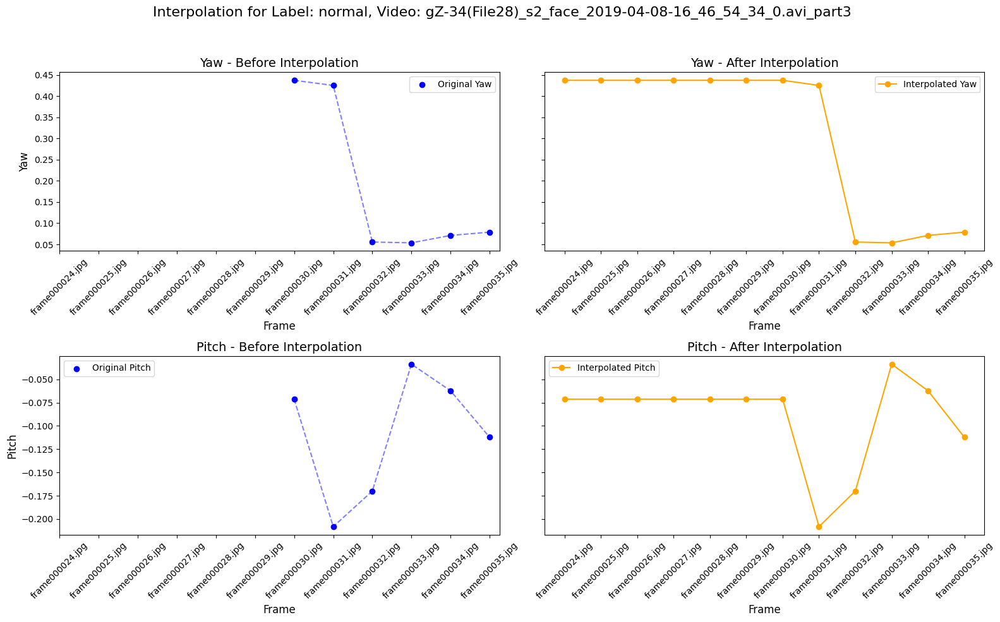

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

def visualize_interpolation(df, label, video_name):
    """
    특정 label과 video_name에 대해 선형 보간 전후의 yaw와 pitch 데이터를 시각화합니다.

    Args:
        df (pd.DataFrame): 원본 데이터프레임.
        label (str): 대상 라벨.
        video_name (str): 대상 비디오 이름.

    Returns:
        None
    """
    # 대상 데이터 필터링
    filtered_df = df[(df['label'] == label) & (df['video_name'] == video_name)].sort_values(by='frame').reset_index(drop=True)

    # 선형 보간 수행
    interpolated_df = filtered_df.copy()
    interpolated_df['pitch'] = interpolated_df['pitch'].interpolate(method='linear', limit_direction='both')
    interpolated_df['yaw'] = interpolated_df['yaw'].interpolate(method='linear', limit_direction='both')

    # 모든 frame 값을 확보
    all_frames = filtered_df['frame']

    # 시각화
    fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # 2x2 서브플롯 생성

    # Yaw - Before Interpolation
    axes[0, 0].scatter(filtered_df['frame'], filtered_df['yaw'], label='Original Yaw', color='blue')  # 마커만 표시
    axes[0, 0].plot(filtered_df['frame'], filtered_df['yaw'], linestyle='--', color='blue', alpha=0.5)  # 선 추가
    axes[0, 0].set_title("Yaw - Before Interpolation", fontsize=14)
    axes[0, 0].set_ylabel("Yaw", fontsize=12)
    axes[0, 0].set_xlabel("Frame", fontsize=12)
    axes[0, 0].set_xticks(all_frames)  # 모든 frame 값을 X축에 표시
    axes[0, 0].tick_params(axis='x', rotation=45)  # X축 레이블 회전
    axes[0, 0].legend(fontsize=10)

    # Yaw - After Interpolation
    axes[0, 1].plot(interpolated_df['frame'], interpolated_df['yaw'], 'o-', label='Interpolated Yaw', color='orange')
    axes[0, 1].set_title("Yaw - After Interpolation", fontsize=14)
    axes[0, 1].set_xlabel("Frame", fontsize=12)
    axes[0, 1].set_xticks(all_frames)  # 모든 frame 값을 X축에 표시
    axes[0, 1].tick_params(axis='x', rotation=45)  # X축 레이블 회전
    axes[0, 1].tick_params(axis='y', labelleft=False)  # y축 레이블 숨김
    axes[0, 1].legend(fontsize=10)

    # Pitch - Before Interpolation
    axes[1, 0].scatter(filtered_df['frame'], filtered_df['pitch'], label='Original Pitch', color='blue')  # 마커만 표시
    axes[1, 0].plot(filtered_df['frame'], filtered_df['pitch'], linestyle='--', color='blue', alpha=0.5)  # 선 추가
    axes[1, 0].set_title("Pitch - Before Interpolation", fontsize=14)
    axes[1, 0].set_ylabel("Pitch", fontsize=12)
    axes[1, 0].set_xlabel("Frame", fontsize=12)
    axes[1, 0].set_xticks(all_frames)  # 모든 frame 값을 X축에 표시
    axes[1, 0].tick_params(axis='x', rotation=45)  # X축 레이블 회전
    axes[1, 0].legend(fontsize=10)

    # Pitch - After Interpolation
    axes[1, 1].plot(interpolated_df['frame'], interpolated_df['pitch'], 'o-', label='Interpolated Pitch', color='orange')
    axes[1, 1].set_title("Pitch - After Interpolation", fontsize=14)
    axes[1, 1].set_xlabel("Frame", fontsize=12)
    axes[1, 1].set_xticks(all_frames)  # 모든 frame 값을 X축에 표시
    axes[1, 1].tick_params(axis='x', rotation=45)  # X축 레이블 회전
    axes[1, 1].tick_params(axis='y', labelleft=False)  # y축 레이블 숨김
    axes[1, 1].legend(fontsize=10)

    # 전체 제목 추가 및 레이아웃 조정
    fig.suptitle(f"Interpolation for Label: {label}, Video: {video_name}", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])  # 제목과 그래프 간격 조정
    plt.show()

label = "normal" # 결측치 6개 - 초반에 손으로 카메라를 가리는 6 프레임
video_name = "gZ-34(File28)_s2_face_2019-04-08-16_46_54_34_0.avi_part3"
visualize_interpolation(final_df, label, video_name)

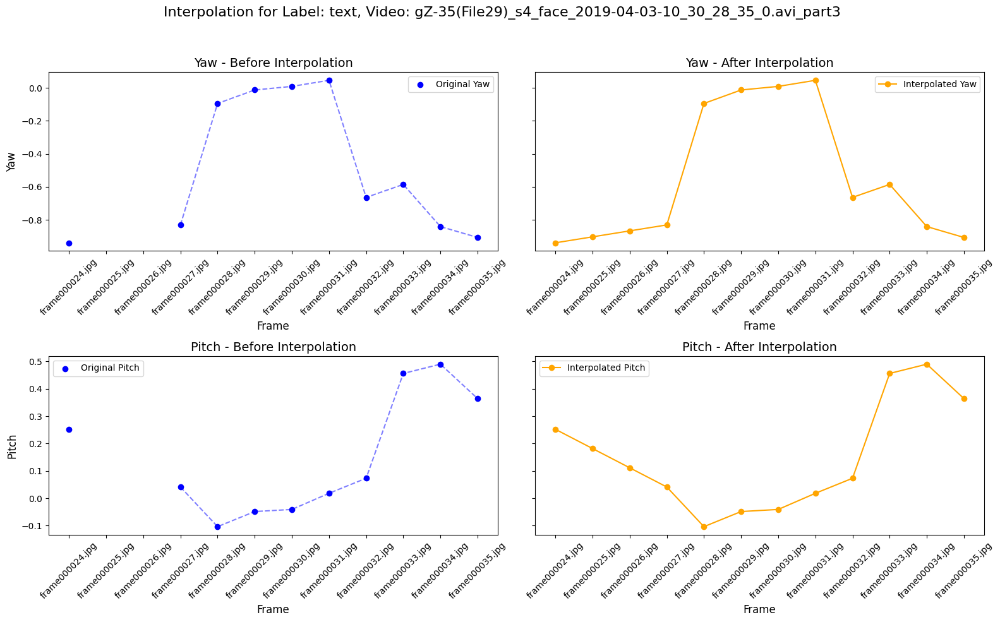

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

def visualize_interpolation(df, label, video_name):
    """
    특정 label과 video_name에 대해 선형 보간 전후의 yaw와 pitch 데이터를 시각화합니다.

    Args:
        df (pd.DataFrame): 원본 데이터프레임.
        label (str): 대상 라벨.
        video_name (str): 대상 비디오 이름.

    Returns:
        None
    """
    # 대상 데이터 필터링
    filtered_df = df[(df['label'] == label) & (df['video_name'] == video_name)].sort_values(by='frame').reset_index(drop=True)

    # 선형 보간 수행
    interpolated_df = filtered_df.copy()
    interpolated_df['pitch'] = interpolated_df['pitch'].interpolate(method='linear', limit_direction='both')
    interpolated_df['yaw'] = interpolated_df['yaw'].interpolate(method='linear', limit_direction='both')

    # 모든 frame 값을 확보
    all_frames = filtered_df['frame']

    # 시각화
    fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # 2x2 서브플롯 생성

    # Yaw - Before Interpolation
    axes[0, 0].scatter(filtered_df['frame'], filtered_df['yaw'], label='Original Yaw', color='blue')  # 마커만 표시
    axes[0, 0].plot(filtered_df['frame'], filtered_df['yaw'], linestyle='--', color='blue', alpha=0.5)  # 선 추가
    axes[0, 0].set_title("Yaw - Before Interpolation", fontsize=14)
    axes[0, 0].set_ylabel("Yaw", fontsize=12)
    axes[0, 0].set_xlabel("Frame", fontsize=12)
    axes[0, 0].set_xticks(all_frames)  # 모든 frame 값을 X축에 표시
    axes[0, 0].tick_params(axis='x', rotation=45)  # X축 레이블 회전
    axes[0, 0].legend(fontsize=10)

    # Yaw - After Interpolation
    axes[0, 1].plot(interpolated_df['frame'], interpolated_df['yaw'], 'o-', label='Interpolated Yaw', color='orange')
    axes[0, 1].set_title("Yaw - After Interpolation", fontsize=14)
    axes[0, 1].set_xlabel("Frame", fontsize=12)
    axes[0, 1].set_xticks(all_frames)  # 모든 frame 값을 X축에 표시
    axes[0, 1].tick_params(axis='x', rotation=45)  # X축 레이블 회전
    axes[0, 1].tick_params(axis='y', labelleft=False)  # y축 레이블 숨김
    axes[0, 1].legend(fontsize=10)

    # Pitch - Before Interpolation
    axes[1, 0].scatter(filtered_df['frame'], filtered_df['pitch'], label='Original Pitch', color='blue')  # 마커만 표시
    axes[1, 0].plot(filtered_df['frame'], filtered_df['pitch'], linestyle='--', color='blue', alpha=0.5)  # 선 추가
    axes[1, 0].set_title("Pitch - Before Interpolation", fontsize=14)
    axes[1, 0].set_ylabel("Pitch", fontsize=12)
    axes[1, 0].set_xlabel("Frame", fontsize=12)
    axes[1, 0].set_xticks(all_frames)  # 모든 frame 값을 X축에 표시
    axes[1, 0].tick_params(axis='x', rotation=45)  # X축 레이블 회전
    axes[1, 0].legend(fontsize=10)

    # Pitch - After Interpolation
    axes[1, 1].plot(interpolated_df['frame'], interpolated_df['pitch'], 'o-', label='Interpolated Pitch', color='orange')
    axes[1, 1].set_title("Pitch - After Interpolation", fontsize=14)
    axes[1, 1].set_xlabel("Frame", fontsize=12)
    axes[1, 1].set_xticks(all_frames)  # 모든 frame 값을 X축에 표시
    axes[1, 1].tick_params(axis='x', rotation=45)  # X축 레이블 회전
    axes[1, 1].tick_params(axis='y', labelleft=False)  # y축 레이블 숨김
    axes[1, 1].legend(fontsize=10)

    # 전체 제목 추가 및 레이아웃 조정
    fig.suptitle(f"Interpolation for Label: {label}, Video: {video_name}", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])  # 제목과 그래프 간격 조정
    plt.show()

label = "text" # 결측치 2개
video_name = "gZ-35(File29)_s4_face_2019-04-03-10_30_28_35_0.avi_part3"
visualize_interpolation(final_df, label, video_name)

## 선형보간 후 csv 저장

In [ ]:
def interpolate_and_save(df, output_dir):
    """
    df 데이터를 label_dataset, video_name, frame 순서대로 정렬 후 선형 보간하고,
    label_dataset별로 CSV 파일로 저장합니다.

    Args:
        df (pd.DataFrame): 원본 데이터프레임.
        output_dir (str): 결과 CSV 파일을 저장할 디렉토리 경로.

    Returns:
        None
    """
    # label_dataset 컬럼 생성
    if 'label_dataset' not in df.columns:
        df['label_dataset'] = df['label'] + '_' + df['dataset']

    # 데이터 정렬
    df = df.sort_values(by=['label_dataset', 'video_name', 'frame']).reset_index(drop=True)

    # 그룹별 보간 함수 정의
    def interpolate_group(group):
        group['pitch'] = group['pitch'].interpolate(method='linear', limit_direction='both')
        group['yaw'] = group['yaw'].interpolate(method='linear', limit_direction='both')
        return group

    # 출력 디렉토리 생성
    os.makedirs(output_dir, exist_ok=True)

    # label_dataset별로 그룹화하여 보간 수행 및 CSV 저장
    for label_dataset, group in df.groupby('label_dataset'):
        interpolated_group = group.groupby(['video_name']).apply(interpolate_group).reset_index(drop=True)
        output_file = os.path.join(output_dir, f"{label_dataset}.csv")
        try:
            interpolated_group.to_csv(output_file, index=False)
            print(f"Successfully saved interpolated data to {output_file}")
        except Exception as e:
            print(f"Error saving interpolated data for {label_dataset}: {e}")

output_dir = '/content/drive/MyDrive/DMS/data/EDA/yaw_pitch_interpolated_results'
interpolate_and_save(df, output_dir)


<ipython-input-102-8645a6fd8d14>:31: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  interpolated_group = group.groupby(['video_name']).apply(interpolate_group).reset_index(drop=True)


Successfully saved interpolated data to /content/drive/MyDrive/DMS/data/EDA/yaw_pitch_interpolated_results/normal_DMD.csv


<ipython-input-102-8645a6fd8d14>:31: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  interpolated_group = group.groupby(['video_name']).apply(interpolate_group).reset_index(drop=True)


Successfully saved interpolated data to /content/drive/MyDrive/DMS/data/EDA/yaw_pitch_interpolated_results/normal_yawDD.csv


<ipython-input-102-8645a6fd8d14>:31: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  interpolated_group = group.groupby(['video_name']).apply(interpolate_group).reset_index(drop=True)


Successfully saved interpolated data to /content/drive/MyDrive/DMS/data/EDA/yaw_pitch_interpolated_results/phonecall_DMD.csv


<ipython-input-102-8645a6fd8d14>:31: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  interpolated_group = group.groupby(['video_name']).apply(interpolate_group).reset_index(drop=True)


Successfully saved interpolated data to /content/drive/MyDrive/DMS/data/EDA/yaw_pitch_interpolated_results/text_DMD.csv
Successfully saved interpolated data to /content/drive/MyDrive/DMS/data/EDA/yaw_pitch_interpolated_results/yawn_yawDD.csv


<ipython-input-102-8645a6fd8d14>:31: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  interpolated_group = group.groupby(['video_name']).apply(interpolate_group).reset_index(drop=True)


In [ ]:
inter_df = merge_saved_csvs(output_dir)
len(trainset_video_frame_info) - len(inter_df)

0

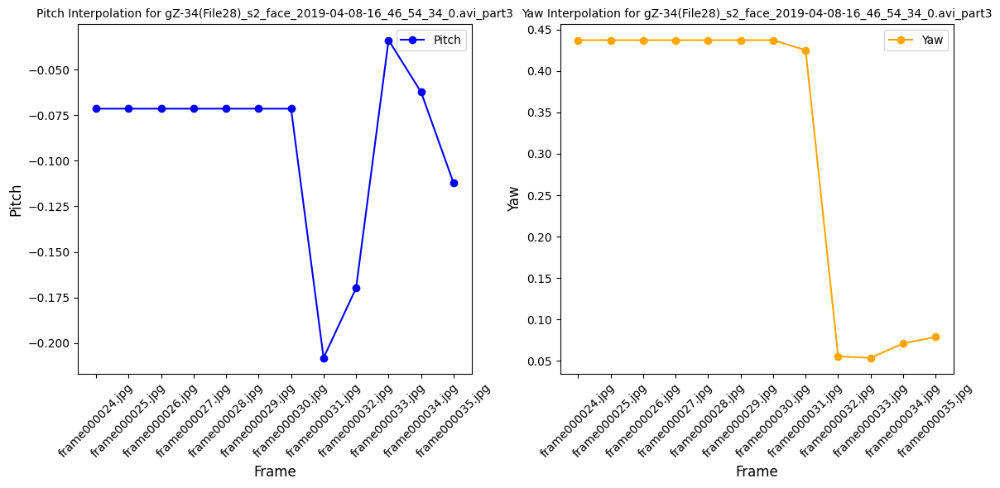

In [ ]:
delattref visualize_interpolation(inter_df, label, video_name):
    """
    특정 label과 video_name에 대해 선형 보간 결과를 시각화합니다.

    Args:
        inter_df (pd.DataFrame): 선형 보간된 데이터프레임.
        label (str): 대상 라벨.
        video_name (str): 대상 비디오 이름.

    Returns:
        None
    """
    # 대상 데이터 필터링
    filtered_df = inter_df[(inter_df['label'] == label) & (inter_df['video_name'] == video_name)].sort_values(by='frame').reset_index(drop=True)

    # 시각화
    plt.figure(figsize=(12, 6))

    # Pitch 시각화
    plt.subplot(1, 2, 1)
    plt.plot(filtered_df['frame'], filtered_df['pitch'], 'o-', label='Pitch', color='blue')
    plt.title(f"Pitch Interpolation for {video_name}", fontsize=10)
    plt.xlabel("Frame", fontsize=12)
    plt.ylabel("Pitch", fontsize=12)
    plt.xticks(rotation=45)
    plt.legend()

    # Yaw 시각화
    plt.subplot(1, 2, 2)
    plt.plot(filtered_df['frame'], filtered_df['yaw'], 'o-', label='Yaw', color='orange')
    plt.title(f"Yaw Interpolation for {video_name}", fontsize=10)
    plt.xlabel("Frame", fontsize=12)
    plt.ylabel("Yaw", fontsize=12)
    plt.xticks(rotation=45)
    plt.legend()

    # 그래프 출력
    plt.tight_layout()
    plt.show()

label = "normal"
video_name = "gZ-34(File28)_s2_face_2019-04-08-16_46_54_34_0.avi_part3"
visualize_interpolation(inter_df, label, video_name)

# 시각화

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
df = merge_saved_csvs('/content/drive/MyDrive/DMS/data/EDA/yaw_pitch_interpolated_results')

In [ ]:
# 각 비디오별로 프레임 번호를 시간 순서로 매핑
df["time"] = df.groupby(['label', 'video_name']).cumcount()

## 시간 흐름별 yaw, pitch 절댓값 추이

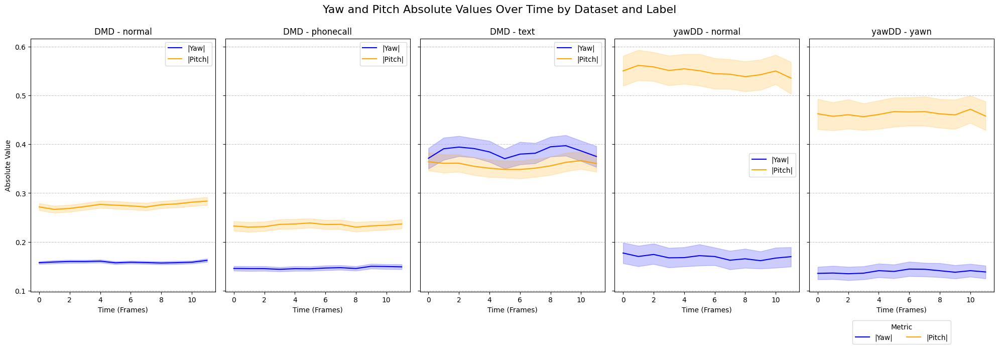

In [ ]:
# 데이터셋과 레이블 조합 정의
plot_configs = [
    {"dataset": "DMD", "label": "normal"},
    {"dataset": "DMD", "label": "phonecall"},
    {"dataset": "DMD", "label": "text"},
    {"dataset": "yawDD", "label": "normal"},
    {"dataset": "yawDD", "label": "yawn"}
]

# 수평으로 5개의 플롯 생성
fig, axes = plt.subplots(1, 5, figsize=(20, 6), sharey=True)  # y축 공유

for i, config in enumerate(plot_configs):
    dataset = config["dataset"]
    label = config["label"]

    # 데이터 필터링
    subset = df[(df['dataset'] == dataset) & (df['label'] == label)]

    if subset.empty:  # 데이터가 없으면 스킵
        continue

    # Yaw 절댓값 시각화
    sns.lineplot(
        data=subset,
        x='time',
        y=np.abs(subset['yaw']),  # Yaw 절댓값
        ax=axes[i],               # 현재 subplot에 그림
        color="blue",
        label="|Yaw|"
    )

    # Pitch 절댓값 시각화
    sns.lineplot(
        data=subset,
        x='time',
        y=np.abs(subset['pitch']),  # Pitch 절댓값
        ax=axes[i],                 # 현재 subplot에 그림
        color="orange",
        label="|Pitch|"
    )

    # 제목 설정
    axes[i].set_title(f"{dataset} - {label}")

    # x축과 y축 레이블 설정
    axes[i].set_xlabel("Time (Frames)")
    if i == 0:  # 첫 번째 플롯만 y축 레이블 표시
        axes[i].set_ylabel("Absolute Value")

    # y축 그리드 추가
    axes[i].grid(axis='y', linestyle='--', alpha=0.7)  # 점선 스타일과 투명도 설정

# 전체 레이아웃 조정 및 범례 추가
plt.tight_layout()
plt.legend(title="Metric", loc='upper center', bbox_to_anchor=(0.5, -0.1), ncol=2)
plt.suptitle("Yaw and Pitch Absolute Values Over Time by Dataset and Label", fontsize=16, y=1.05)
plt.show()

## 시간 흐름별 yaw, pitch 절댓값 추이(mirror, dash 분리)

In [ ]:
sns.set_theme(style="whitegrid")
color_palette = sns.color_palette("Set2")

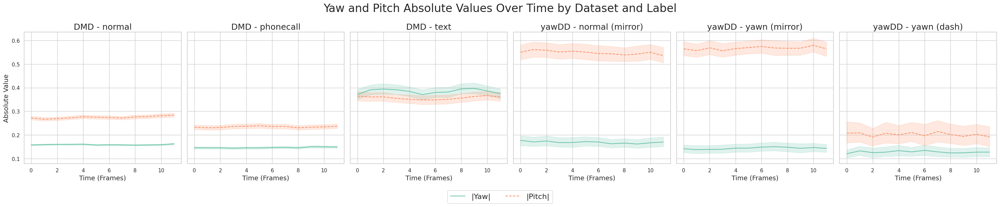

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Seaborn 스타일 설정
sns.set_theme(style="whitegrid")
color_palette = sns.color_palette("Set2")

# 데이터셋과 레이블 조합 정의 (yawDD-yawn을 mirror와 dash로 나눔)
plot_configs = [
    {"dataset": "DMD", "label": "normal"},
    {"dataset": "DMD", "label": "phonecall"},
    {"dataset": "DMD", "label": "text"},
    {"dataset": "yawDD", "label": "normal", "prefix": "mirror"},
    {"dataset": "yawDD", "label": "yawn", "prefix": "mirror"},  # mirror 추가
    {"dataset": "yawDD", "label": "yawn", "prefix": "dash"}     # dash 추가
]

# 1행 6열로 플롯 생성
fig, axes = plt.subplots(1, len(plot_configs), figsize=(30, 6), sharey=True)  # y축 공유

# 범례 핸들 및 라벨 저장용 리스트
all_handles = []
all_labels = []

for i, config in enumerate(plot_configs):
    dataset = config["dataset"]
    label = config["label"]
    prefix = config.get("prefix", None)  # prefix 키가 없으면 None 반환

    # 데이터 필터링
    if prefix:  # prefix가 있는 경우 (yawDD-yawn의 mirror 또는 dash)
        subset = df[
            (df['dataset'] == dataset) &
            (df['label'] == label) &
            (df['video_name'].str.split("_").str[0].str.startswith(prefix))
        ]
        title = f"{dataset} - {label} ({prefix})"
    else:  # 일반적인 dataset-label 조합
        subset = df[
            (df['dataset'] == dataset) &
            (df['label'] == label)
        ]
        title = f"{dataset} - {label}"

    if subset.empty:  # 데이터가 없으면 텍스트 표시
        axes[i].text(0.5, 0.5, 'No Data Available', ha='center', va='center', fontsize=12, color='gray')
        axes[i].set_visible(True)
        axes[i].set_title(title, fontsize=18)
        continue

    # Yaw 절댓값 시각화
    yaw_line = sns.lineplot(
        data=subset,
        x='time',
        y=np.abs(subset['yaw']),  # Yaw 절댓값
        ax=axes[i],               # 현재 subplot에 그림
        color=color_palette[0],
        linestyle='solid',
        legend=False,
        label="|Yaw|"             # 라벨 지정
    )

    # Pitch 절댓값 시각화
    pitch_line = sns.lineplot(
        data=subset,
        x='time',
        y=np.abs(subset['pitch']),  # Pitch 절댓값
        ax=axes[i],                 # 현재 subplot에 그림
        color=color_palette[1],
        linestyle='dashed',
        legend=False,
        label="|Pitch|"             # 라벨 지정
    )

    # 첫 번째 플롯에서만 핸들 및 라벨 수집 (범례용)
    handles, labels = axes[i].get_legend_handles_labels()
    if i == 0:
        all_handles.extend(handles)
        all_labels.extend(labels)

    # 제목 설정
    axes[i].set_title(title, fontsize=18)

    # x축 레이블 설정 (공유된 y축은 첫 번째 플롯만 표시)
    axes[i].set_xlabel("Time (Frames)", fontsize=14)
    if i == 0:
        axes[i].set_ylabel("Absolute Value", fontsize=14)

# 전체 플롯에 대해 하나의 범례 추가
fig.legend(
    handles=all_handles,          # 저장된 핸들을 사용해 범례 생성
    labels=all_labels,            # 저장된 라벨을 사용해 범례 생성
    loc='lower center',           # 범례를 하단 중앙으로 이동
    ncol=2,                       # 두 열로 정렬
    fontsize=16,
    frameon=True,
)

# 전체 레이아웃 조정 및 제목 추가
plt.tight_layout(rect=[0, 0.1, 1, 0.95])  # 제목과 그래프 간 여백 조정 (rect 조정)
plt.suptitle("Yaw and Pitch Absolute Values Over Time by Dataset and Label", fontsize=24, y=1.02)  # 전체 제목 글씨 크기 확대 및 위치 조정
plt.show()


## frame별 yaw, pitch 절댓값 분포

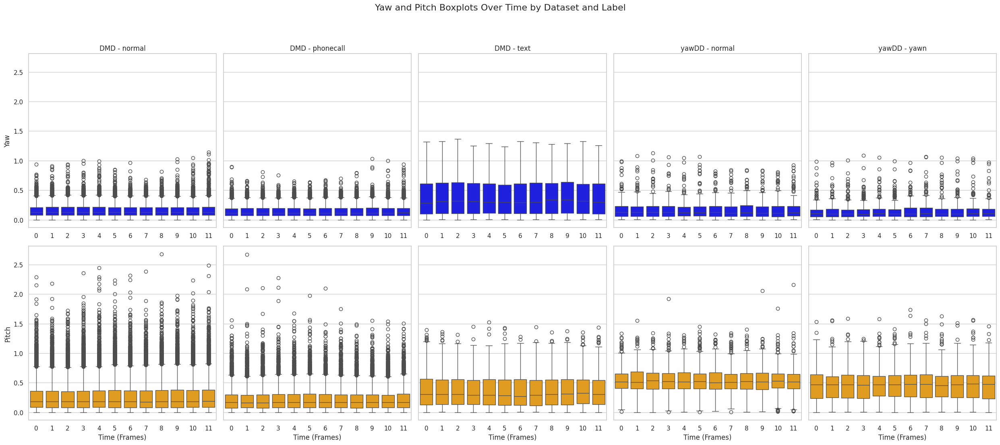

In [ ]:
# 데이터셋과 레이블 조합 정의
plot_configs = [
    {"dataset": "DMD", "label": "normal"},
    {"dataset": "DMD", "label": "phonecall"},
    {"dataset": "DMD", "label": "text"},
    {"dataset": "yawDD", "label": "normal"},
    {"dataset": "yawDD", "label": "yawn"}
]

# 2행 5열의 플롯 생성 (1행: yaw, 2행: pitch, y축 공유)
fig, axes = plt.subplots(2, 5, figsize=(25, 12), sharey=True)  # y축 공유

for i, config in enumerate(plot_configs):
    dataset = config["dataset"]
    label = config["label"]

    # 데이터 필터링
    subset = df[(df['dataset'] == dataset) & (df['label'] == label)]

    if subset.empty:  # 데이터가 없으면 스킵
        continue

    # Yaw Boxplot 시각화 (1행)
    sns.boxplot(
        data=subset,
        x='time',
        y=np.abs(subset['yaw']),  # Yaw 절댓값
        ax=axes[0, i],
        color="blue"
    )
    axes[0, i].set_title(f"{dataset} - {label}")  # 제목 설정
    axes[0, i].set_xlabel(None)
    if i == 0:
        axes[0, i].set_ylabel("Yaw")  # 첫 번째 열만 y축 레이블 표시

    # Pitch Boxplot 시각화 (2행)
    sns.boxplot(
        data=subset,
        x='time',
        y=np.abs(subset['pitch']),  # Pitch 절댓값
        ax=axes[1, i],
        color="orange"
    )
    axes[1, i].set_xlabel("Time (Frames)")
    if i == 0:
        axes[1, i].set_ylabel("Pitch")  # 첫 번째 열만 y축 레이블 표시

plt.tight_layout(rect=[0, 0.1, 1, 0.95])  # 제목과 그래프 간 여백 조정 (rect 조정)
plt.suptitle("Yaw and Pitch Boxplots Over Time by Dataset and Label", fontsize=16, y=1.02)
plt.show()

## frame별 yaw, pitch 절댓값 분포(mirror, dash 분리)

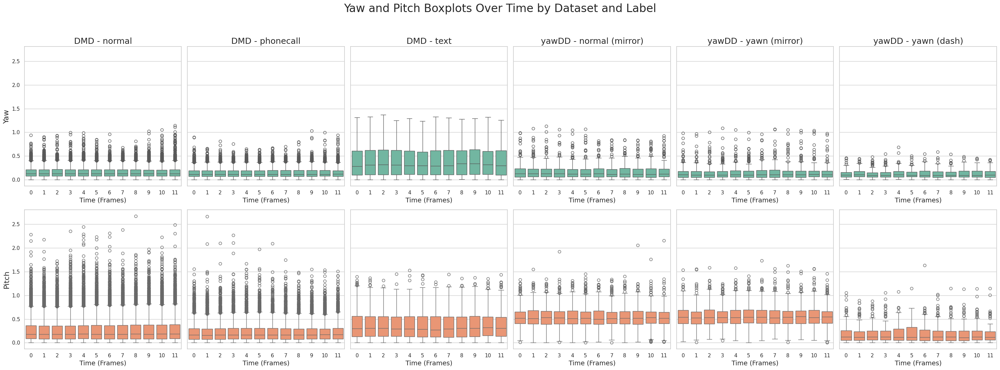

In [ ]:
# 데이터셋과 레이블 조합 정의 (yawDD-yawn을 mirror와 dash로 나눔)
plot_configs = [
    {"dataset": "DMD", "label": "normal"},
    {"dataset": "DMD", "label": "phonecall"},
    {"dataset": "DMD", "label": "text"},
    {"dataset": "yawDD", "label": "normal", "prefix": "mirror"},
    {"dataset": "yawDD", "label": "yawn", "prefix": "mirror"},  # mirror 추가
    {"dataset": "yawDD", "label": "yawn", "prefix": "dash"}     # dash 추가
]

# 2행 6열의 플롯 생성 (1행: yaw, 2행: pitch, y축 공유)
fig, axes = plt.subplots(2, len(plot_configs), figsize=(30, 12), sharey=True)  # y축 공유

for i, config in enumerate(plot_configs):
    dataset = config["dataset"]
    label = config["label"]
    prefix = config.get("prefix", None)  # prefix 키가 없으면 None 반환

    # 데이터 필터링
    if prefix:  # prefix가 있는 경우 (yawDD-yawn의 mirror 또는 dash)
        subset = df[
            (df['dataset'] == dataset) &
            (df['label'] == label) &
            (df['video_name'].str.split("_").str[0].str.startswith(prefix))  # 수정된 부분
        ]
        title = f"{dataset} - {label} ({prefix})"
    else:  # 일반적인 dataset-label 조합
        subset = df[
            (df['dataset'] == dataset) &
            (df['label'] == label)
        ]
        title = f"{dataset} - {label}"

    if subset.empty:  # 데이터가 없으면 스킵
        axes[0, i].set_visible(False)
        axes[1, i].set_visible(False)
        continue

    # Yaw Boxplot 시각화 (1행)
    sns.boxplot(
        data=subset,
        x='time',
        y=np.abs(subset['yaw']),  # Yaw 절댓값
        color=color_palette[0],
        ax=axes[0, i]
    )
    axes[0, i].set_title(title, fontsize=18)  # 제목 글씨 크기 확대
    axes[0, i].set_xlabel("Time (Frames)", fontsize=14)  # x축 레이블 글씨 크기 확대
    if i == 0:
        axes[0, i].set_ylabel("Yaw", fontsize=16)  # y축 레이블 글씨 크기 확대

    # Pitch Boxplot 시각화 (2행)
    sns.boxplot(
        data=subset,
        x='time',
        y=np.abs(subset['pitch']),  # Pitch 절댓값
        color=color_palette[1],
        ax=axes[1, i]
    )
    axes[1, i].set_xlabel("Time (Frames)", fontsize=14)  # x축 레이블 글씨 크기 확대
    if i == 0:
        axes[1, i].set_ylabel("Pitch", fontsize=16)  # y축 레이블 글씨 크기 확대

# 전체 레이아웃 조정 및 제목 추가
plt.tight_layout(rect=[0, 0.1, 1, 0.95])  # 제목과 그래프 간 여백 조정 (rect 조정)
plt.suptitle("Yaw and Pitch Boxplots Over Time by Dataset and Label", fontsize=24, y=1.02)  # 전체 제목 글씨 크기 확대
plt.show()

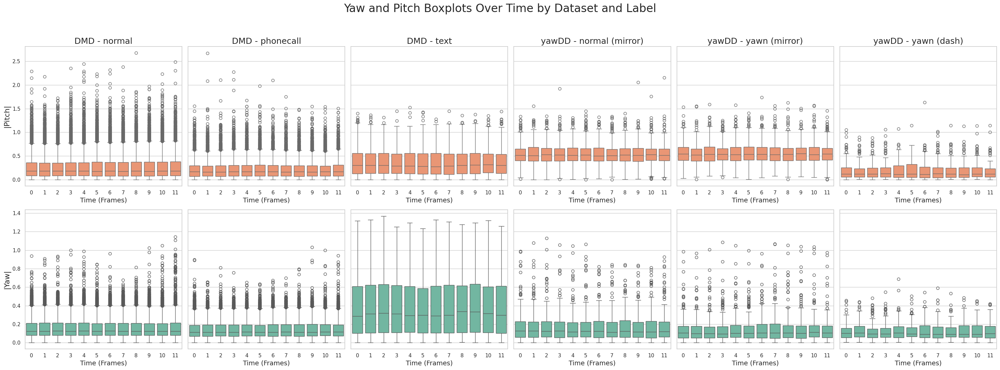

In [ ]:
# 데이터셋과 레이블 조합 정의 (yawDD-yawn을 mirror와 dash로 나눔)
plot_configs = [
    {"dataset": "DMD", "label": "normal"},
    {"dataset": "DMD", "label": "phonecall"},
    {"dataset": "DMD", "label": "text"},
    {"dataset": "yawDD", "label": "normal", "prefix": "mirror"},
    {"dataset": "yawDD", "label": "yawn", "prefix": "mirror"},  # mirror 추가
    {"dataset": "yawDD", "label": "yawn", "prefix": "dash"}     # dash 추가
]

# 2행 6열의 플롯 생성 (1행: yaw, 2행: pitch, y축은 각 행별로 공유)
fig, axes = plt.subplots(2, len(plot_configs), figsize=(30, 12), sharey='row')  # 행별로 y축 공유

for i, config in enumerate(plot_configs):
    dataset = config["dataset"]
    label = config["label"]
    prefix = config.get("prefix", None)  # prefix 키가 없으면 None 반환

    # 데이터 필터링
    if prefix:  # prefix가 있는 경우 (yawDD-yawn의 mirror 또는 dash)
        subset = df[
            (df['dataset'] == dataset) &
            (df['label'] == label) &
            (df['video_name'].str.split("_").str[0].str.startswith(prefix))  # 수정된 부분
        ]
        title = f"{dataset} - {label} ({prefix})"
    else:  # 일반적인 dataset-label 조합
        subset = df[
            (df['dataset'] == dataset) &
            (df['label'] == label)
        ]
        title = f"{dataset} - {label}"

    if subset.empty:  # 데이터가 없으면 스킵
        axes[0, i].set_visible(False)
        axes[1, i].set_visible(False)
        continue

    # Yaw Boxplot 시각화 (1행)
    sns.boxplot(
        data=subset,
        x='time',
        y=np.abs(subset['yaw']),  # Yaw 절댓값
        color=color_palette[0],
        ax=axes[1, i]
    )
    axes[0, i].set_title(title, fontsize=18)  # 제목 글씨 크기 확대
    axes[0, i].set_xlabel("Time (Frames)", fontsize=14)  # x축 레이블 글씨 크기 확대
    axes[1, i].set_ylabel("|Yaw|", fontsize=16)  # y축 레이블 글씨 크기 확대

    # Pitch Boxplot 시각화 (2행)
    sns.boxplot(
        data=subset,
        x='time',
        y=np.abs(subset['pitch']),  # Pitch 절댓값
        color=color_palette[1],
        ax=axes[0, i]
    )
    axes[1, i].set_xlabel("Time (Frames)", fontsize=14)  # x축 레이블 글씨 크기 확대
    axes[0, i].set_ylabel("|Pitch|", fontsize=16)  # y축 레이블 글씨 크기 확대

# 전체 레이아웃 조정 및 제목 추가
plt.tight_layout(rect=[0, 0.1, 1, 0.95])  # 제목과 그래프 간 여백 조정 (rect 조정)
plt.suptitle("Yaw and Pitch Boxplots Over Time by Dataset and Label", fontsize=24, y=1.02)  # 전체 제목 글씨 크기 확대
plt.show()

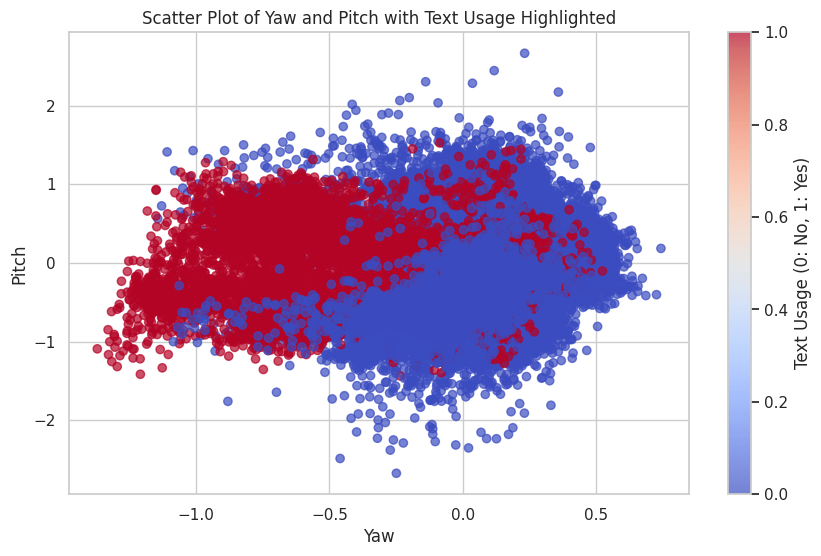

In [ ]:
df["text_usage"] = (df['label'] == 'text').astype(int)
plt.figure(figsize=(10, 6))
plt.scatter(df["yaw"], df["pitch"], c=df["text_usage"], cmap='coolwarm', alpha=0.7)
plt.xlabel("Yaw")
plt.ylabel("Pitch")
plt.title("Scatter Plot of Yaw and Pitch with Text Usage Highlighted")
plt.colorbar(label="Text Usage (0: No, 1: Yes)")
plt.show()

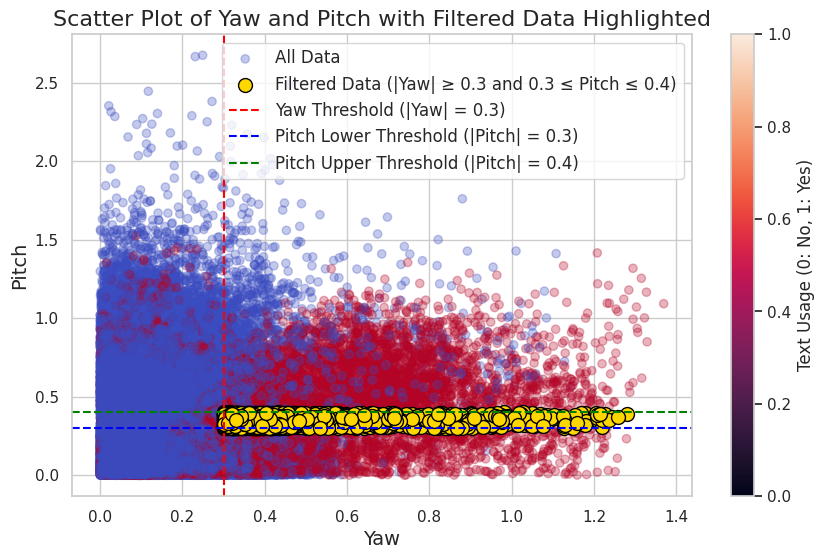

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# 데이터 필터링 조건
filtered_data = df[
    (np.abs(df["yaw"]) >= 0.3) &  # Yaw 절댓값이 0.3 이상
    (np.abs(df["pitch"]) >= 0.3) &       # Pitch가 0.3 이상
    (np.abs(df["pitch"]) <= 0.4)         # Pitch가 0.4 이하
]

text_usage = (df['label'] == 'text').astype(int)

# 산점도 작성
plt.figure(figsize=(10, 6))

# 전체 데이터 산점도 (배경으로 표시)
plt.scatter(np.abs(df["yaw"]), np.abs(df["pitch"]), c=text_usage, cmap='coolwarm', alpha=0.3, label="All Data")

# 필터링된 데이터 산점도 (강조 표시)
plt.scatter(
    np.abs(filtered_data["yaw"]),
    np.abs(filtered_data["pitch"]),
    c='gold',
    edgecolor='black',
    s=100,
    label="Filtered Data (|Yaw| ≥ 0.3 and 0.3 ≤ Pitch ≤ 0.4)"
)

# 임계값 표시
plt.axvline(x=0.3, color='red', linestyle='--', label="Yaw Threshold (|Yaw| = 0.3)")
plt.axhline(y=0.3, color='blue', linestyle='--', label="Pitch Lower Threshold (|Pitch| = 0.3)")
plt.axhline(y=0.4, color='green', linestyle='--', label="Pitch Upper Threshold (|Pitch| = 0.4)")

# 축 및 제목 설정
plt.xlabel("Yaw", fontsize=14)
plt.ylabel("Pitch", fontsize=14)
plt.title("Scatter Plot of Yaw and Pitch with Filtered Data Highlighted", fontsize=16)

# 범례 및 색상바 추가
plt.legend(fontsize=12)
plt.colorbar(label="Text Usage (0: No, 1: Yes)")
plt.show()

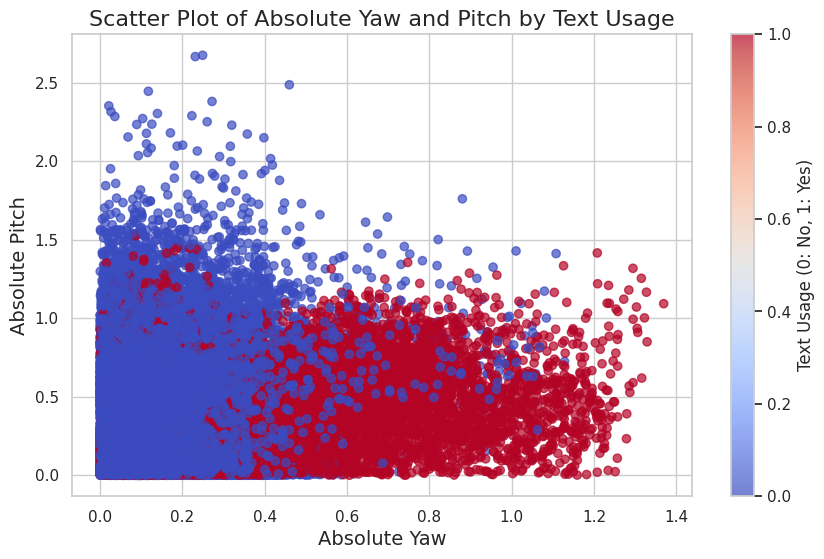

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Yaw와 Pitch의 절댓값 계산
df['abs_yaw'] = np.abs(df['yaw'])
df['abs_pitch'] = np.abs(df['pitch'])

# 문자 사용 여부 (0: No, 1: Yes)
text_usage = (df['label'] == 'text').astype(int)

# 산점도 작성
plt.figure(figsize=(10, 6))

# 문자 사용 여부에 따라 색상 구분
plt.scatter(
    df['abs_yaw'],
    df['abs_pitch'],
    c=text_usage,
    cmap='coolwarm',
    alpha=0.7,
    label="Data Points"
)

# 축 및 제목 설정
plt.xlabel("Absolute Yaw", fontsize=14)
plt.ylabel("Absolute Pitch", fontsize=14)
plt.title("Scatter Plot of Absolute Yaw and Pitch by Text Usage", fontsize=16)

# 색상바 추가 (문자 사용 여부)
plt.colorbar(label="Text Usage (0: No, 1: Yes)")

# 그래프 표시
plt.show()

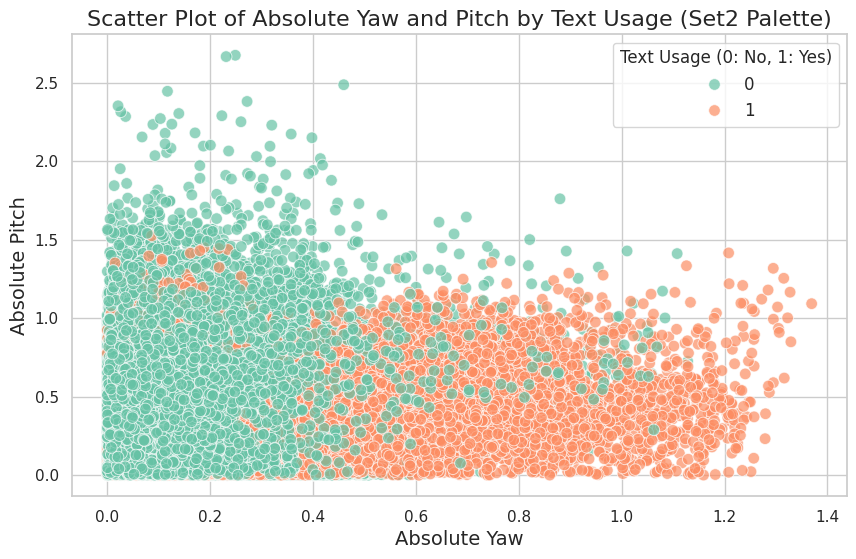

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Seaborn의 Set2 팔레트 설정
palette = sns.color_palette("Set2", 2)  # Set2에서 두 가지 색상 사용

# Yaw와 Pitch의 절댓값 계산
df['abs_yaw'] = np.abs(df['yaw'])
df['abs_pitch'] = np.abs(df['pitch'])

# 문자 사용 여부 (0: No, 1: Yes)
text_usage = (df['label'] == 'text').astype(int)

# 산점도 작성
plt.figure(figsize=(10, 6))

# 문자 사용 여부에 따라 색상 구분 (Set2 팔레트 적용)
sns.scatterplot(
    x=df['abs_yaw'],
    y=df['abs_pitch'],
    hue=text_usage,
    palette=palette,
    alpha=0.7,
    s=70  # 점 크기 설정
)

# 축 및 제목 설정
plt.xlabel("Absolute Yaw", fontsize=14)
plt.ylabel("Absolute Pitch", fontsize=14)
plt.title("Scatter Plot of Absolute Yaw and Pitch by Text Usage (Set2 Palette)", fontsize=16)

# 범례 및 그래프 표시
plt.legend(title="Text Usage (0: No, 1: Yes)", fontsize=12)
plt.show()

## 클립 당 yaw, pitch 분산

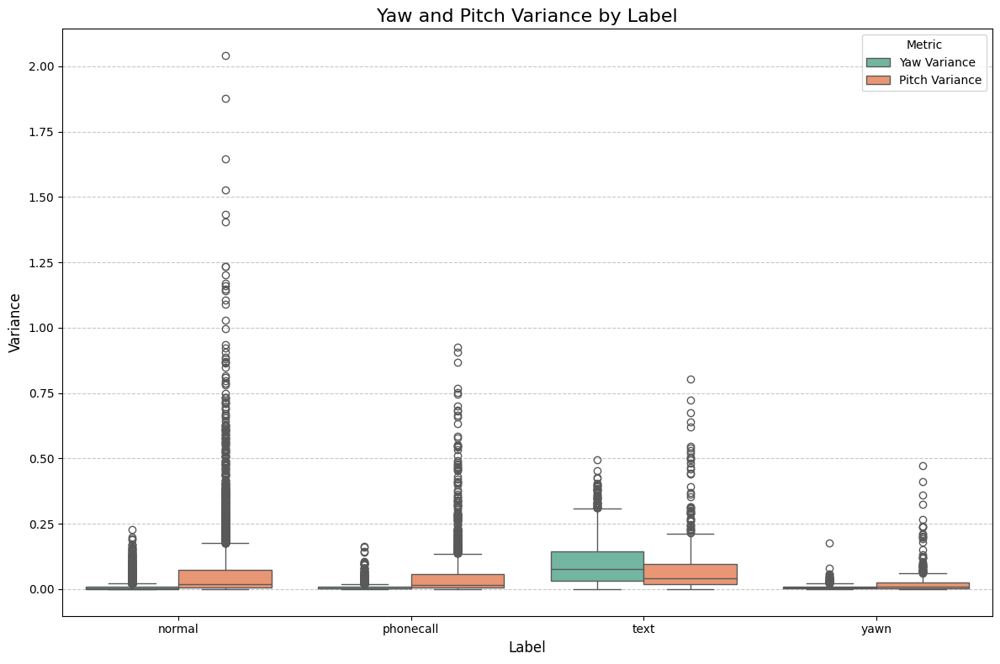

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def visualize_label_frame_variance(df):
    """
    label과 video_name 별로 프레임 내 yaw와 pitch의 분산을 계산하고,
    label 별로 boxplot을 시각화합니다.

    Args:
        df (pd.DataFrame): 원본 데이터프레임. 'label', 'video_name', 'frame', 'yaw', 'pitch' 컬럼이 포함되어야 합니다.

    Returns:
        None
    """
    # 프레임 내 yaw와 pitch의 분산 계산
    variance_df = (
        df.groupby(['label', 'video_name'])
        .agg(yaw_variance=('yaw', 'var'),       # yaw의 분산
             pitch_variance=('pitch', 'var'))  # pitch의 분산
        .reset_index()
    )

    # 긴 형식으로 변환 (Seaborn 사용을 위해)
    melted_df = variance_df.melt(id_vars=['label'],
                                 value_vars=['yaw_variance', 'pitch_variance'],
                                 var_name='metric',
                                 value_name='variance')

    # 시각화
    plt.figure(figsize=(12, 8))
    box_plot = sns.boxplot(
        data=melted_df,
        x='label',
        y='variance',
        hue='metric',
        palette='Set2'
    )

    # 그래프 설정
    plt.title("Yaw and Pitch Variance by Label", fontsize=16)
    plt.xlabel("Label", fontsize=12)
    plt.ylabel("Variance", fontsize=12)

    # 범례 수정: Seaborn이 자동으로 생성한 범례를 재설정
    handles, labels = box_plot.get_legend_handles_labels()
    plt.legend(handles=handles, labels=["Yaw Variance", "Pitch Variance"], title="Metric", loc='upper right')

    # y축 그리드 추가
    plt.grid(axis='y', linestyle='--', alpha=0.7)

    # 그래프 출력
    plt.tight_layout()
    plt.show()

visualize_label_frame_variance(df)

### 분산 이상치 확인

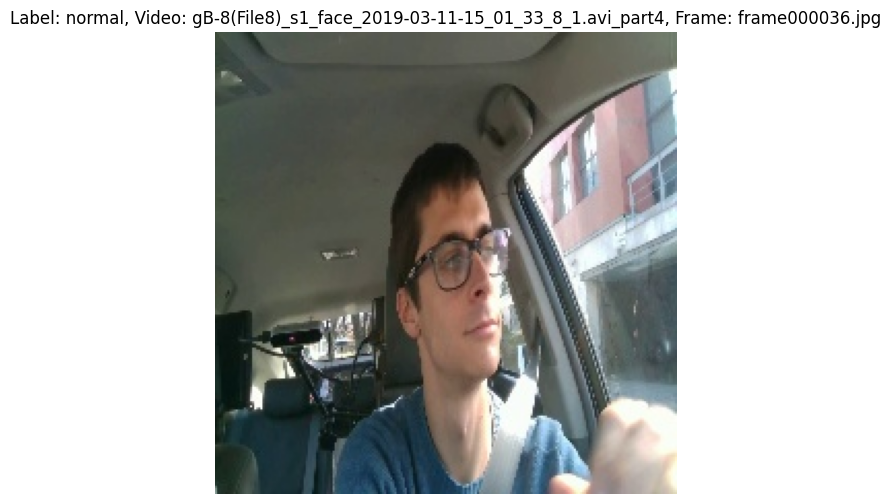

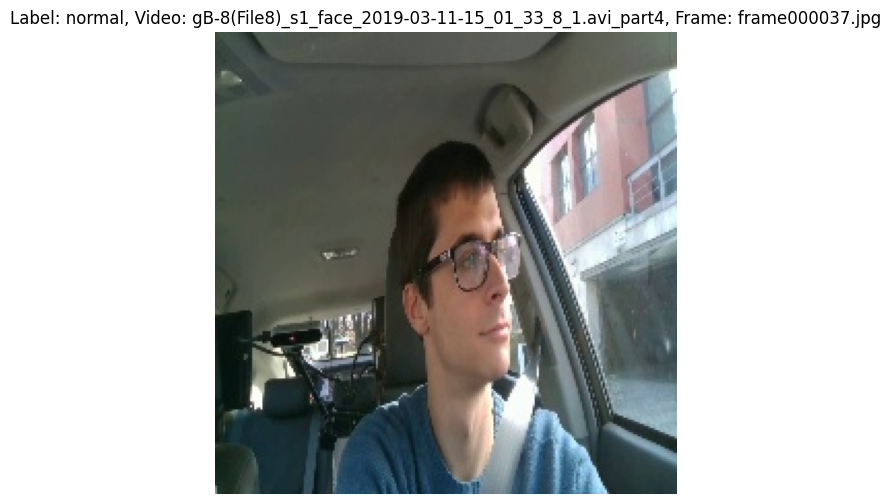

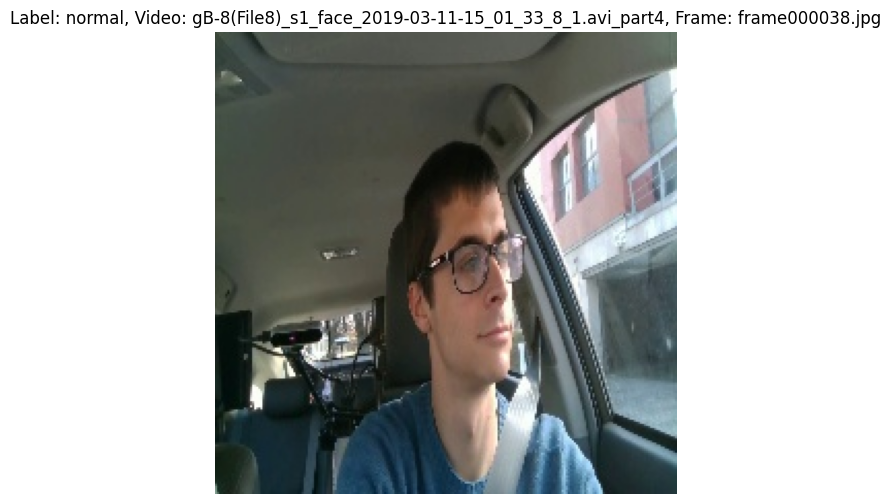

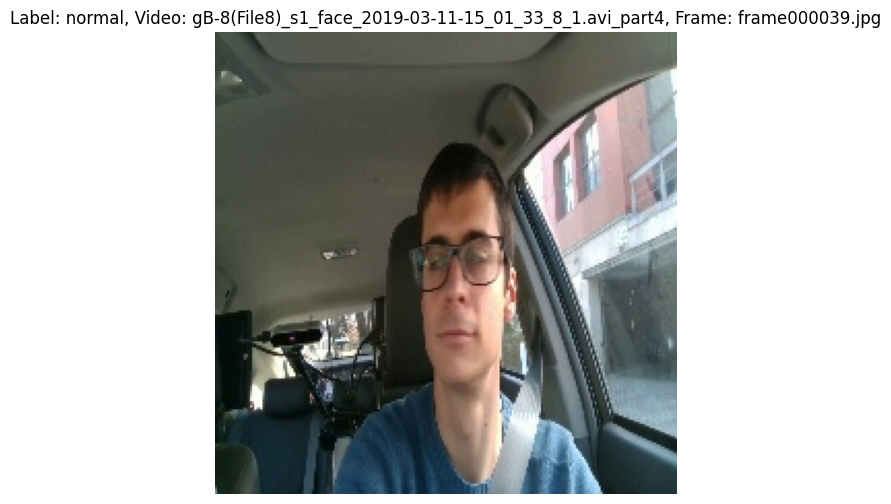

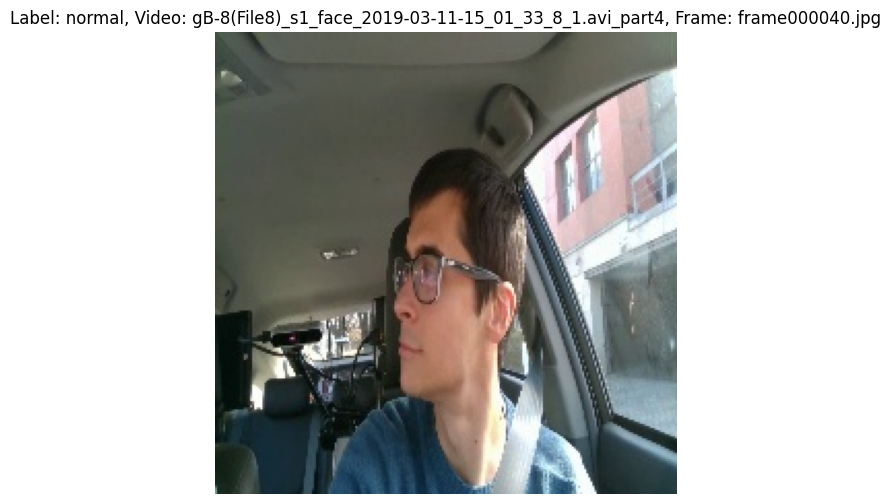

...

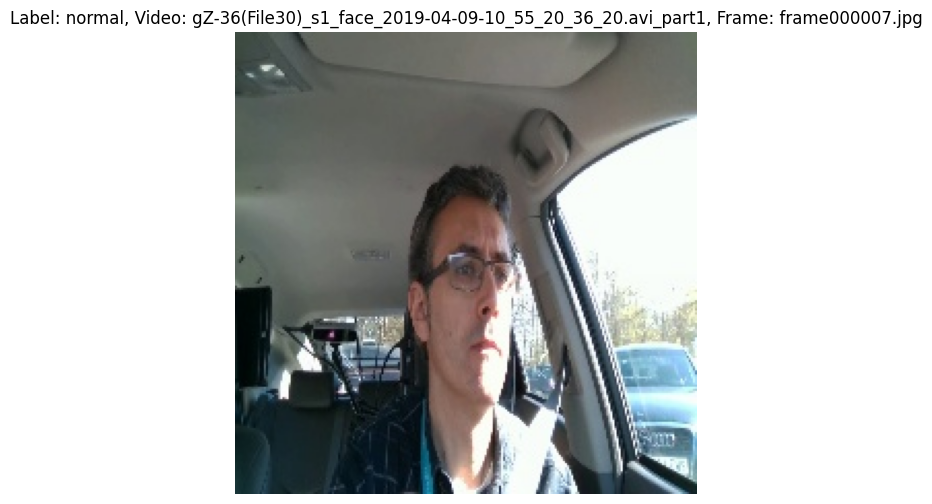

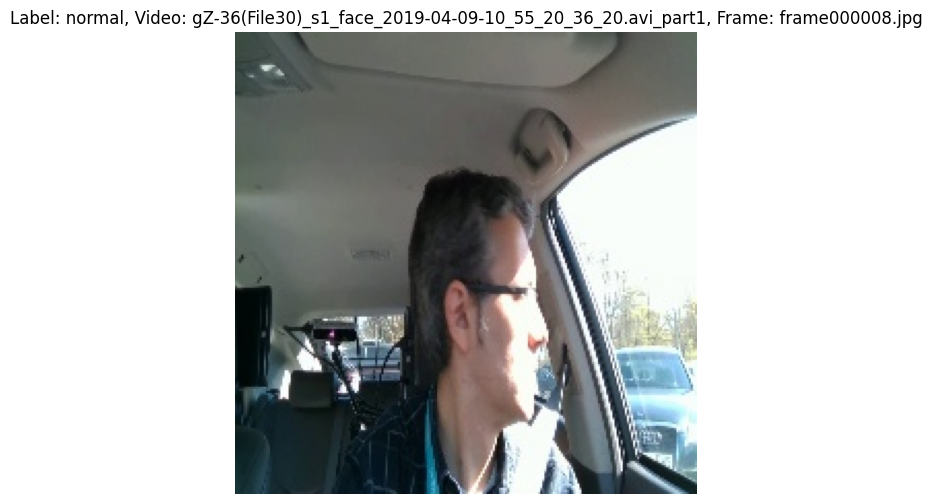

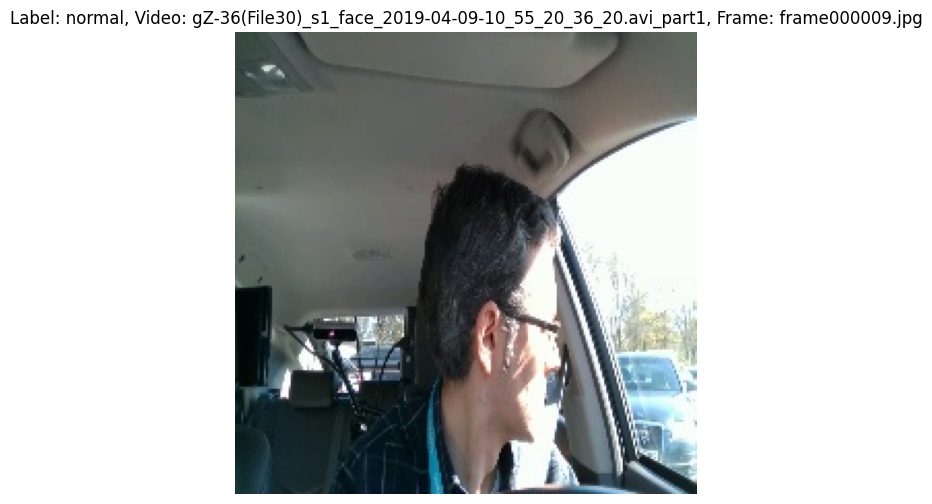

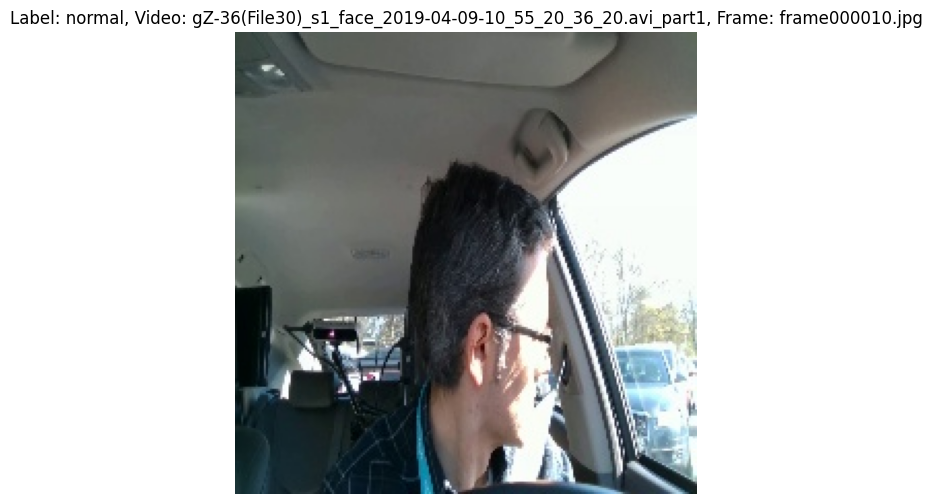

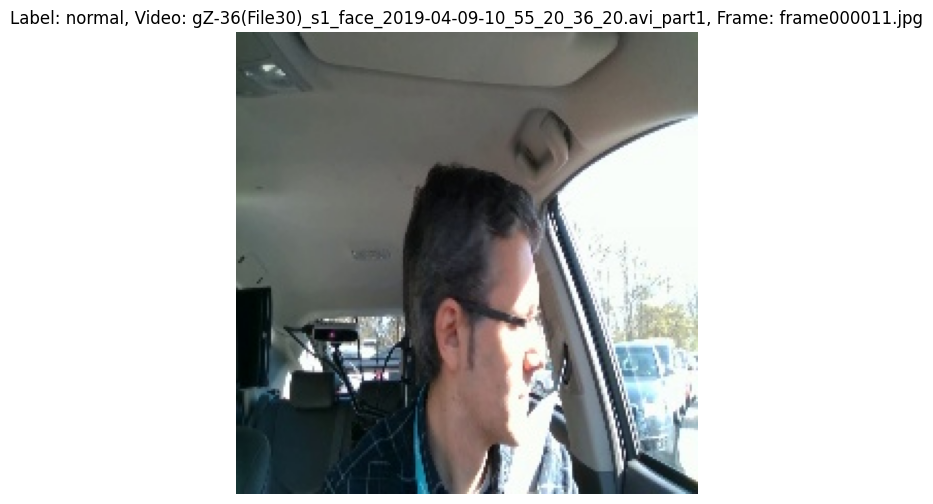

In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image

def filter_and_display_images(df, image_base_dir, variance_threshold=1.5):
    """
    yaw 또는 pitch의 분산이 특정 임계값 이상인 프레임들을 필터링하고,
    해당 프레임의 이미지를 표시합니다.

    Args:
        df (pd.DataFrame): 원본 데이터프레임. 'yaw', 'pitch', 'video_name', 'frame' 컬럼이 포함되어야 합니다.
        image_base_dir (str): 이미지가 저장된 기본 디렉토리.
        variance_threshold (float): 분산 임계값.

    Returns:
        None
    """
    # 프레임 내 yaw와 pitch의 분산 계산
    variance_df = (
        df.groupby(['label', 'video_name'])
        .agg(yaw_variance=('yaw', 'var'),       # yaw의 분산
             pitch_variance=('pitch', 'var'))  # pitch의 분산
        .reset_index()
    )

    # 분산 임계값을 초과하는 video_name 필터링
    high_variance_videos = variance_df[
        (variance_df['yaw_variance'] > variance_threshold) |
        (variance_df['pitch_variance'] > variance_threshold)
    ]['video_name'].unique()

    # 원본 데이터에서 해당 video_name에 속한 프레임 필터링
    high_variance_frames = df[df['video_name'].isin(high_variance_videos)]

    # 이미지 경로 생성 및 표시
    for _, row in high_variance_frames.iterrows():
        image_path = os.path.join(image_base_dir, row['label'] + "_" + row['dataset'], row['video_name'], row['frame'])

        try:
            # 이미지 열기
            img = Image.open(image_path)

            # 이미지 표시
            plt.figure(figsize=(6, 6))
            plt.imshow(img)
            plt.axis('off')
            plt.title(f"Label: {row['label']}, Video: {row['video_name']}, Frame: {row['frame']}")
            plt.show()
        except Exception as e:
            print(f"Error loading image {image_path}: {e}")

# 사용 예시
image_base_dir = "/content/drive/MyDrive/DMS/data/train_test_split_dataset/train_dataset"
filter_and_display_images(df, image_base_dir, variance_threshold=1.5)

In [ ]:
interpolated_df = merge_saved_csvs("/content/drive/MyDrive/DMS/data/EDA/yaw_pitch_interpolated_results")

In [ ]:
interpolated_df.groupby('label').apply(lambda x: x[['yaw', 'pitch']].isnull().any(axis=1).sum())

<ipython-input-4-1d2dc60f56b1>:1: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  interpolated_df.groupby('label').apply(lambda x: x[['yaw', 'pitch']].isnull().any(axis=1).sum())


,0
label,
normal,0
phonecall,0
text,0
yawn,0


## yaw delta, pitch delta

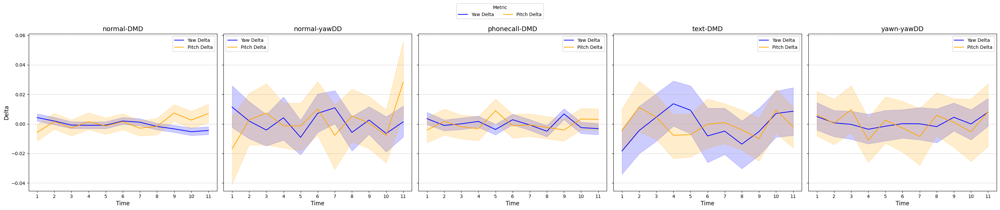

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import MaxNLocator

def visualize_label_dataset_delta(df):
    """
    label-dataset 별로 프레임 간 yaw와 pitch의 변화량(델타) 추이를 시각화합니다.
    모든 그래프를 한 행에 표시하며, Y축을 통일합니다.

    Args:
        df (pd.DataFrame): 원본 데이터프레임. 'label', 'dataset', 'video_name', 'time', 'yaw', 'pitch' 컬럼이 포함되어야 합니다.

    Returns:
        None
    """
    # 데이터 정렬 (label, dataset, video_name, time 순서)
    df = df.sort_values(by=['label', 'dataset', 'video_name', 'time']).reset_index(drop=True)

    # 프레임 간 yaw와 pitch 변화량(델타) 계산
    df['yaw_delta'] = df.groupby(['label', 'dataset', 'video_name'])['yaw'].diff()
    df['pitch_delta'] = df.groupby(['label', 'dataset', 'video_name'])['pitch'].diff()

    # label-dataset 조합 생성
    df['label_dataset'] = df['label'] + '-' + df['dataset']

    # label-dataset 별로 고유한 값 추출
    label_datasets = df['label_dataset'].unique()

    # 서브플롯 생성 (한 행에 모든 그래프 배치)
    num_plots = len(label_datasets)
    fig, axes = plt.subplots(1, num_plots, figsize=(6 * num_plots, 6), sharey=True)  # Y축 통일

    for i, label_dataset in enumerate(label_datasets):
        subset_df = df[df['label_dataset'] == label_dataset]

        sns.lineplot(
            data=subset_df,
            x='time',
            y='yaw_delta',
            ax=axes[i],
            label='Yaw Delta',
            color='blue'
        )
        sns.lineplot(
            data=subset_df,
            x='time',
            y='pitch_delta',
            ax=axes[i],
            label='Pitch Delta',
            color='orange'
        )

        # X축 눈금 설정 (최대 12개로 제한)
        axes[i].xaxis.set_major_locator(MaxNLocator(nbins=12))  # 최대 12개의 눈금

        # 그래프 설정
        axes[i].set_title(f"{label_dataset}", fontsize=14)
        axes[i].set_xlabel("Time", fontsize=12)
        if i == 0:  # 첫 번째 플롯만 Y축 레이블 표시
            axes[i].set_ylabel("Delta", fontsize=12)
        axes[i].grid(axis='y', linestyle='--', alpha=0.7)

    # 범례 설정 (첫 번째 플롯에만 표시)
    handles, labels = axes[0].get_legend_handles_labels()
    fig.legend(handles, labels, title="Metric", loc='upper center', bbox_to_anchor=(0.5, 1.05), ncol=2)

    # 전체 레이아웃 조정 및 출력
    plt.tight_layout(rect=[0, 0, 1, 0.95])  # 범례 공간 확보
    plt.show()

visualize_label_dataset_delta(df)

# 선형보간 후 LSTM

## train, validation set 분리

In [ ]:
from sklearn.model_selection import train_test_split

# Step 1: 사람별 ID 추출
def get_person_id(video_name):
    """
    video_name에서 사람별 ID를 추출합니다.
    """
    return video_name.split("_")[0]  # 예: "dash#", "mirror#", "gA#" 등

# 데이터에 person_id 열 추가
df['person_id'] = df['video_name'].apply(get_person_id)

# Step 2: 사람별로 train과 validation 세트 나누기
def split_by_person(data, test_size=0.2, random_state=42):
    """
    사람별로 데이터를 train과 validation 세트로 나눕니다.

    Args:
        data (pd.DataFrame): 전체 데이터프레임.
        test_size (float): validation 세트 비율.
        random_state (int): 랜덤 시드 값.

    Returns:
        train_data (pd.DataFrame): Train 데이터프레임.
        validation_data (pd.DataFrame): Validation 데이터프레임.
    """
    # 고유한 person_id 목록 추출
    unique_person_ids = data['person_id'].unique()

    # person_id를 기준으로 train/validation 분리
    train_ids, validation_ids = train_test_split(unique_person_ids, test_size=test_size, random_state=random_state)

    # train/validation 데이터프레임 생성
    train_data = data[data['person_id'].isin(train_ids)]
    validation_data = data[data['person_id'].isin(validation_ids)]

    return train_data, validation_data

# Train/Validation 분리
train_data_origin, validation_data_origin = split_by_person(df)

# Step 3: 라벨별 비율 확인 함수
def check_label_distribution(data, label_column='label'):
    """
    데이터에서 라벨별 비율을 계산합니다.

    Args:
        data (pd.DataFrame): 입력 데이터프레임.
        label_column (str): 라벨 컬럼 이름.

    Returns:
        pd.Series: 라벨별 비율.
    """
    label_counts = data[label_column].value_counts(normalize=True) * 100  # 비율 계산 (%)
    return label_counts

# Train/Validation의 라벨별 비율 확인
train_label_distribution = check_label_distribution(train_data_origin)
validation_label_distribution = check_label_distribution(validation_data_origin)

# 결과 출력
print("Train Label Distribution (%):")
print(train_label_distribution)

print("\nValidation Label Distribution (%):")
print(validation_label_distribution)

# Train/Validation 데이터 크기 확인
print(f"\nTrain Data: {len(train_data_origin)} rows")
print(f"Validation Data: {len(validation_data_origin)} rows")

Train Label Distribution (%):
label
normal       62.678311
phonecall    24.133916
text          8.922853
yawn          4.264920
Name: proportion, dtype: float64

Validation Label Distribution (%):
label
normal       60.106667
phonecall    24.000000
text         11.946667
yawn          3.946667
Name: proportion, dtype: float64

Train Data: 82440 rows
Validation Data: 22500 rows


### 프레임 이미지 시각화할 때 필요한 label_dataset 컬럼 추가

In [ ]:
train_data_origin['label_dataset'] = train_data_origin['label_dataset'].replace({
    'yawn_yawDD': 'yawn_yawDD_0309',
    'normal_yawDD': 'normal_yawDD_0309'
})

validation_data_origin['label_dataset'] = validation_data_origin['label_dataset'].replace({
    'yawn_yawDD': 'yawn_yawDD_0309',
    'normal_yawDD': 'normal_yawDD_0309'
})

['normal_DMD' 'normal_yawDD_0309' 'phonecall_DMD' 'text_DMD'
 'yawn_yawDD_0309']


<ipython-input-166-2b23ea1be61e>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_data_origin['label_dataset'] = train_data_origin['label_dataset'].replace({


### train, validation data exclusive 검증

In [ ]:
# Train/Validation 데이터가 exclusive한지 검증
def check_exclusivity(train_data, validation_data):
    """
    Train과 Validation 데이터가 서로 exclusive한지 검증합니다.

    Args:
        train_data (pd.DataFrame): Train 데이터프레임.
        validation_data (pd.DataFrame): Validation 데이터프레임.

    Returns:
        None: 결과를 출력합니다.
    """
    # person_id 중복 확인
    overlapping_person_ids = set(train_data['person_id']).intersection(set(validation_data['person_id']))

    # video_name 중복 확인
    overlapping_video_names = set(train_data['video_name']).intersection(set(validation_data['video_name']))

    if len(overlapping_person_ids) == 0 and len(overlapping_video_names) == 0:
        print("Train and Validation datasets are exclusive.")
    else:
        print("Train and Validation datasets are NOT exclusive.")
        if len(overlapping_person_ids) > 0:
            print(f"Overlapping person_ids: {overlapping_person_ids}")
        if len(overlapping_video_names) > 0:
            print(f"Overlapping video_names: {overlapping_video_names}")

# Exclusivity 검증 실행
check_exclusivity(train_data_origin, validation_data_origin)

Train and Validation datasets are exclusive.


In [ ]:
# text가 아닌데 text로 예측한 비디오, text인데 다른 행동으로 예측한 비디오 정보 저장
results_path = '/content/drive/MyDrive/DMS/data/model_results/only_yaw_pitch'

## random seed 설정

In [ ]:
import tensorflow as tf
import random

# Step 0: Random Seed 설정
def set_random_seed(seed=42):
    """
    랜덤 시드를 설정하여 결과 재현성을 보장합니다.
    """
    np.random.seed(seed)  # NumPy 랜덤 시드 설정
    random.seed(seed)     # Python random 모듈 시드 설정
    tf.random.set_seed(seed)  # TensorFlow 랜덤 시드 설정

# 랜덤 시드 설정
set_random_seed(42)

## 잘못 예측한 데이터를 저장하고 시각화하는 함수

In [ ]:
import os
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt

def process_and_visualize_misclassified_data(true_labels, predicted_labels, y_val, norm_val_df, label_encoder, seq_length, results_path, file_name, image_base_dir, num_samples=5):
    """
    잘못된 예측 데이터를 처리하고 저장하며, 시각화합니다.

    Args:
        true_labels (np.array): 실제 라벨 (숫자형).
        predicted_labels (np.array): 예측된 라벨 (숫자형).
        y_val (np.array): Validation 데이터의 라벨 (숫자형).
        norm_val_df (pd.DataFrame): Validation 데이터프레임.
        label_encoder (LabelEncoder): 라벨 인코더 객체.
        seq_length (int): 시퀀스 길이.
        results_path (str): 결과 파일을 저장할 경로.
        image_base_dir (str): 이미지 데이터가 저장된 기본 경로.
        num_samples (int): 시각화할 샘플 개수.
    """
    # Step 10.1: Text가 아닌데 Text로 잘못 예측한 경우
    non_text_as_text_indices = np.where((true_labels != label_encoder.transform(['text'])[0]) &
                                        (predicted_labels == label_encoder.transform(['text'])[0]))[0]

    # Text가 아닌 → Text로 잘못 예측된 데이터프레임 생성
    non_text_as_text_df = pd.DataFrame({
        'label': label_encoder.inverse_transform(y_val[non_text_as_text_indices]),  # 원래 라벨로 변환
        'video_name': [norm_val_df.iloc[i * seq_length]['video_name'] for i in non_text_as_text_indices],
        'label_dataset': [norm_val_df.iloc[i * seq_length]['label_dataset'] for i in non_text_as_text_indices],  # label_dataset 추가
        'predicted_label': 'text'
    })

    # Step 10.2: Text인데 다른 라벨로 잘못 예측한 경우
    text_as_other_indices = np.where((true_labels == label_encoder.transform(['text'])[0]) &
                                      (predicted_labels != label_encoder.transform(['text'])[0]))[0]

    # Text → 다른 라벨로 잘못 예측된 데이터프레임 생성
    text_as_other_df = pd.DataFrame({
        'label': label_encoder.inverse_transform(y_val[text_as_other_indices]),  # 원래 라벨로 변환
        'video_name': [norm_val_df.iloc[i * seq_length]['video_name'] for i in text_as_other_indices],
        'label_dataset': [norm_val_df.iloc[i * seq_length]['label_dataset'] for i in text_as_other_indices],  # label_dataset 추가
        'predicted_label': label_encoder.inverse_transform(predicted_labels[text_as_other_indices])
    })

    # 결과 저장
    non_text_as_text_df.to_csv(os.path.join(results_path, f"{file_name}_non_text_as_text.csv"), index=False)
    text_as_other_df.to_csv(os.path.join(results_path, f"{file_name}_text_as_other.csv"), index=False)

    print("Misclassified data saved successfully.")

    # 시각화 함수 정의
    def visualize_misclassified_images_by_video(df, title_info):
        """
        잘못된 예측 데이터를 각 video_name별로 시각화합니다.

        Args:
            df (pd.DataFrame): 잘못된 예측 데이터프레임.
            title_info (str): 제목에 포함될 정보 ('non_text_as_text' 또는 'text_as_other').
        """
        # 최대 num_samples만큼 샘플링
        sample_df = df.sample(n=min(num_samples, len(df)), random_state=42)

        for _, row in sample_df.iterrows():
            try:
                # 이미지 경로에서 12개의 프레임 로드
                video_dir = os.path.join(image_base_dir, row['label_dataset'], row['video_name'])
                frame_files = sorted(os.listdir(video_dir))[:12]  # 첫 12개의 프레임 선택

                if not frame_files:
                    print(f"No valid image files found in: {video_dir}")
                    continue

                # 새로운 플롯 생성
                plt.figure(figsize=(20, 5))

                for frame_idx, frame_file in enumerate(frame_files):
                    img_path = os.path.join(video_dir, frame_file)
                    img = Image.open(img_path)

                    # 서브플롯 생성 (행: 1, 열: 12)
                    ax = plt.subplot(1, 12, frame_idx + 1)
                    ax.imshow(img)
                    ax.axis('off')
                    ax.set_title(f"Frame {frame_idx + 1}", fontsize=8)

                # 제목에 원하는 정보 추가
                if title_info == "non_text_as_text":
                    plt.suptitle(f"Video: {row['video_name']} | True Label: {row['label']} | Predicted: text", fontsize=14)
                elif title_info == "text_as_other":
                    plt.suptitle(f"Video: {row['video_name']} | True Label: text | Predicted: {row['predicted_label']}", fontsize=14)

                plt.tight_layout()
                plt.show()

            except Exception as e:
                print(f"Error loading images for video: {row['video_name']}, Error: {e}")

    # Non-Text as Text Data 시각화
    print("\nVisualizing Non-Text as Text Data:")
    visualize_misclassified_images_by_video(non_text_as_text_df, title_info="non_text_as_text")

    # Text as Other Data 시각화
    print("\nVisualizing Text as Other Data:")
    visualize_misclassified_images_by_video(text_as_other_df, title_info="text_as_other")

## yaw, pitch

/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 10s 22ms/step - accuracy: 0.6338 - loss: 1.0455 - val_accuracy: 0.6395 - val_loss: 0.8891
Epoch 2/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - accuracy: 0.6713 - loss: 0.8304 - val_accuracy: 0.6533 - val_loss: 0.8723
Epoch 3/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - accuracy: 0.6752 - loss: 0.8107 - val_accuracy: 0.6571 - val_loss: 0.8604
Epoch 4/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 5s 24ms/step - accuracy: 0.6788 - loss: 0.7978 - val_accuracy: 0.6613 - val_loss: 0.8494
Epoch 5/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 5s 23ms/step - accuracy: 0.6819 - loss: 0.7850 - val_accuracy: 0.6667 - val_loss: 0.8414
Epoch 6/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 4s 20ms/step - accuracy: 0.6851 - loss: 0.7772 - val_accuracy: 0.6629 - val_loss: 0.8385
Epoch 7/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step - accuracy: 0.6880 - loss: 0.7684 - val_accuracy: 0.6683 - val_loss: 0.8296
Epoch 8/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 5s 21ms/step - accuracy: 0.6899 - loss: 0.7636 - val_acc

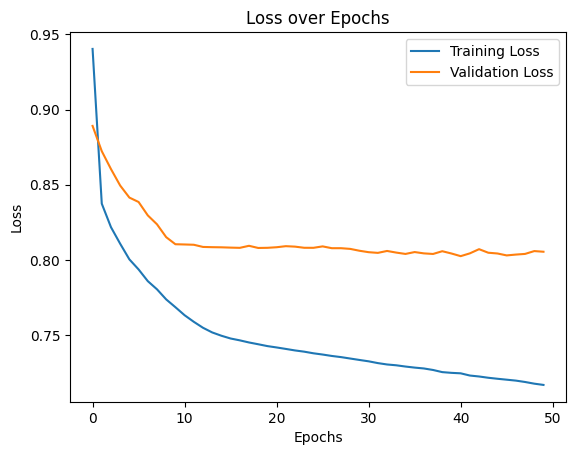

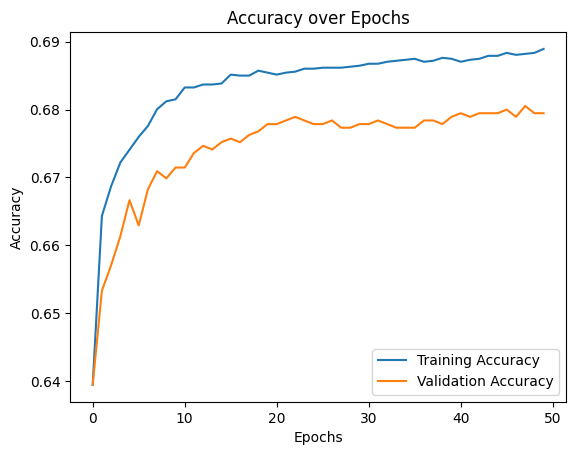

59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.8786 - loss: 0.5434
Validation Loss: 0.8054006695747375, Validation Accuracy: 0.6794666647911072
59/59 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


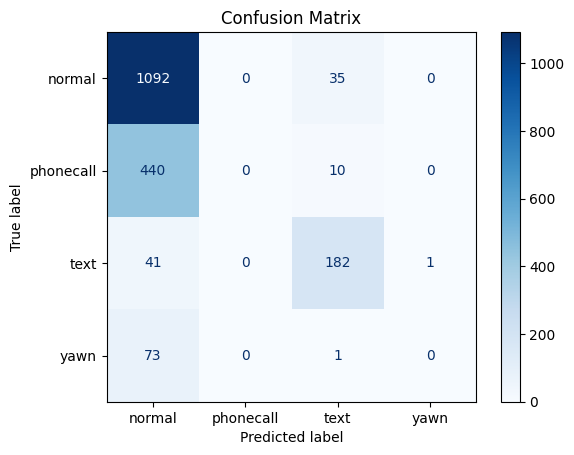


Classification Report:
              precision    recall  f1-score   support

      normal       0.66      0.97      0.79      1127
   phonecall       0.00      0.00      0.00       450
        text       0.80      0.81      0.81       224
        yawn       0.00      0.00      0.00        74

    accuracy                           0.68      1875
   macro avg       0.37      0.45      0.40      1875
weighted avg       0.49      0.68      0.57      1875



/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


NameError: name 'filename' is not defined

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.utils import to_categorical
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report, precision_recall_fscore_support

train_data = train_data_origin.copy()
validation_data = validation_data_origin.copy()

# Step 1: Label Encoding (label을 숫자로 변환)
label_encoder = LabelEncoder()
train_data.loc[:, 'label_encoded'] = label_encoder.fit_transform(train_data['label'])
validation_data.loc[:, 'label_encoded'] = label_encoder.transform(validation_data['label'])  # 동일한 인코딩 사용
num_classes = len(label_encoder.classes_)  # 라벨 클래스 수

# Step 2: 전체 데이터 정규화
def normalize_data(train_data, validation_data):
    """
    전체 데이터를 기준으로 yaw와 pitch 값을 정규화합니다.
    """
    scaler = MinMaxScaler()

    # Train 데이터 정규화
    train_data.loc[:, ['yaw', 'pitch']] = scaler.fit_transform(train_data[['yaw', 'pitch']])

    # Validation 데이터 정규화 (Train 스케일러 사용)
    validation_data.loc[:, ['yaw', 'pitch']] = scaler.transform(validation_data[['yaw', 'pitch']])

    return train_data, validation_data, scaler

# Train/Validation 데이터 정규화
norm_train_df, norm_val_df, scaler = normalize_data(train_data, validation_data)

# Step 3: 클립별 시계열 데이터 생성
def create_video_sequences(data, seq_length=12):
    """
    각 video_name 그룹별로 시계열 데이터를 생성합니다.
    """
    sequences = []
    labels = []

    for (label, video_name), group in data.groupby(['label', 'video_name']):
        group = group.sort_values(by='frame')  # 프레임 순서대로 정렬
        yaw_pitch_data = group[['yaw', 'pitch']].values  # Yaw와 Pitch 값만 사용
        label_encoded = group['label_encoded'].iloc[0]  # 해당 비디오의 라벨 (모든 프레임 동일)

        if len(yaw_pitch_data) >= seq_length:  # 시퀀스 길이 이상인 경우만 처리
            sequences.append(yaw_pitch_data[:seq_length])  # 첫 seq_length 프레임만 사용
            labels.append(label_encoded)

    return np.array(sequences), np.array(labels)

seq_length = 12  # 시퀀스 길이 (프레임 수)
X_train, y_train = create_video_sequences(norm_train_df, seq_length)
X_val, y_val = create_video_sequences(norm_val_df, seq_length)

# Step 4: 라벨을 One-Hot Encoding으로 변환
y_train_one_hot = to_categorical(y_train, num_classes=num_classes)
y_val_one_hot = to_categorical(y_val, num_classes=num_classes)

# Step 5: LSTM 모델 정의
model = Sequential([
    LSTM(64, activation='relu', input_shape=(seq_length, 2), return_sequences=True),
    LSTM(64, activation='relu'),
    Dense(num_classes, activation='softmax')  # 클래스 수만큼 출력 (라벨 예측)
])

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Step 6: 모델 학습
history = model.fit(X_train, y_train_one_hot, epochs=50, batch_size=32, validation_data=(X_val, y_val_one_hot))

# Step 7: 학습 결과 시각화
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.legend()
plt.title('Loss over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.show()

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.legend()
plt.title('Accuracy over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.show()

# Step 8: 테스트 데이터 평가
test_loss, test_accuracy = model.evaluate(X_val, y_val_one_hot)
print(f"Validation Loss: {test_loss}, Validation Accuracy: {test_accuracy}")

# Step 9: 예측 결과 확인 및 혼동 행렬 시각화
predictions = model.predict(X_val)
predicted_labels = np.argmax(predictions, axis=1)  # 예측된 라벨 (숫자형)
true_labels = np.argmax(y_val_one_hot, axis=1)     # 실제 라벨 (숫자형)

cm = confusion_matrix(true_labels, predicted_labels)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_encoder.classes_)
disp.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix")
plt.show()

# Classification Report 출력 (전체 요약)
print("\nClassification Report:")
print(classification_report(true_labels, predicted_labels, target_names=label_encoder.classes_))

Misclassified data saved successfully.

Visualizing Non-Text as Text Data:


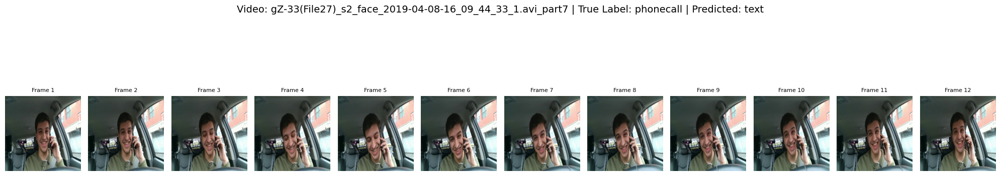

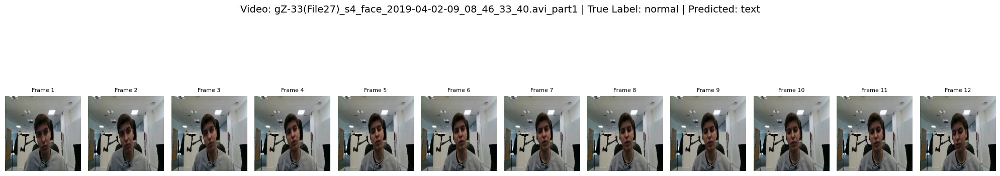

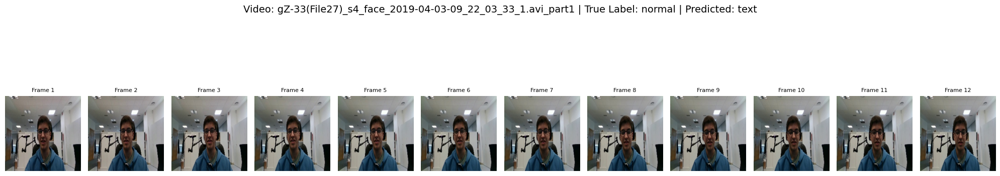

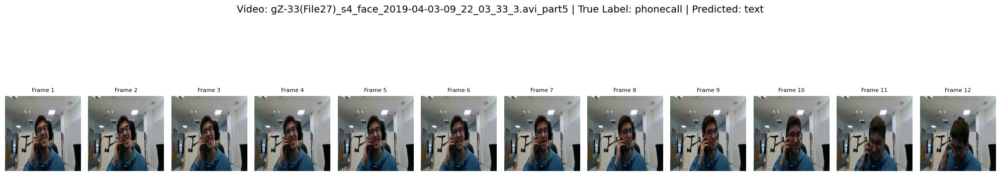

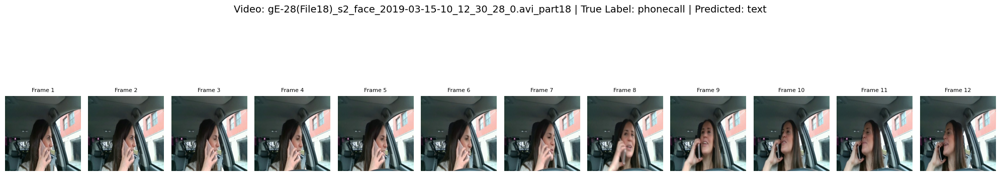


Visualizing Text as Other Data:


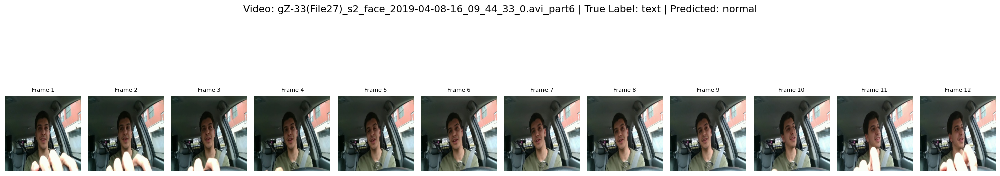

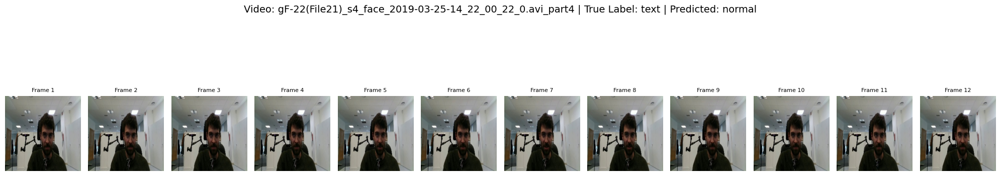

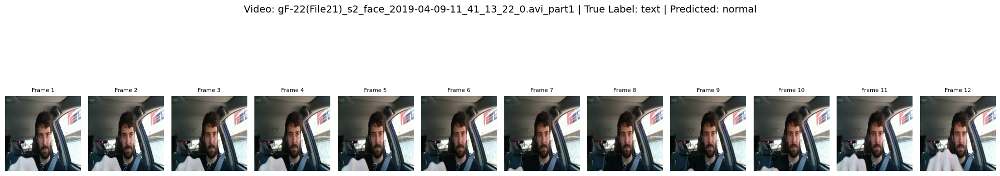

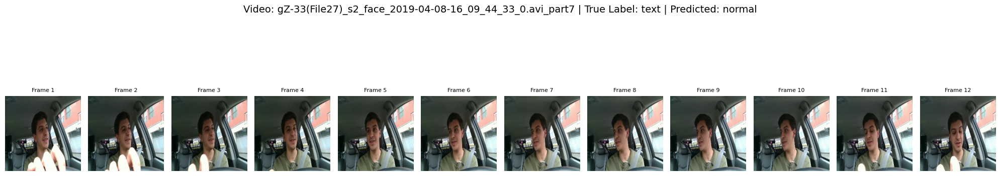

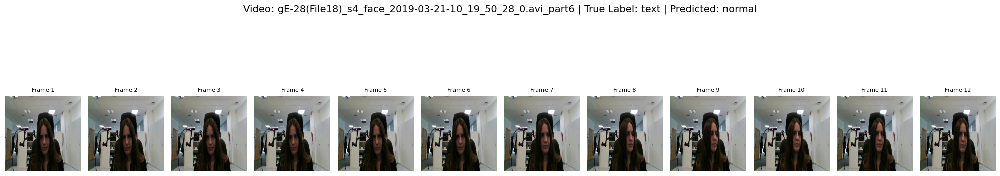

In [ ]:
# Step 10: 잘못된 예측 데이터 저장

# 잘못 예측한 결과 저장 및 시각화
process_and_visualize_misclassified_data(
    true_labels=true_labels,
    predicted_labels=predicted_labels,
    y_val=y_val,
    norm_val_df=norm_val_df,
    label_encoder=label_encoder,
    seq_length=12,
    results_path=results_path,
    file_name='yawpitch',
    image_base_dir=image_base_dir,
    num_samples=5
)

## yaw

Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


215/215 ━━━━━━━━━━━━━━━━━━━━ 9s 22ms/step - accuracy: 0.6002 - loss: 1.0531 - val_accuracy: 0.6011 - val_loss: 0.9588
Epoch 2/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 5s 22ms/step - accuracy: 0.6382 - loss: 0.8771 - val_accuracy: 0.6549 - val_loss: 0.8721
Epoch 3/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - accuracy: 0.6751 - loss: 0.8218 - val_accuracy: 0.6528 - val_loss: 0.8794
Epoch 4/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - accuracy: 0.6752 - loss: 0.8087 - val_accuracy: 0.6571 - val_loss: 0.8693
Epoch 5/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 6s 26ms/step - accuracy: 0.6817 - loss: 0.7952 - val_accuracy: 0.6608 - val_loss: 0.8563
Epoch 6/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - accuracy: 0.6856 - loss: 0.7840 - val_accuracy: 0.6629 - val_loss: 0.8483
Epoch 7/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - accuracy: 0.6876 - loss: 0.7791 - val_accuracy: 0.6672 - val_loss: 0.8404
Epoch 8/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 6s 26ms/step - accuracy: 0.6900 - loss: 0.7727 - val_accuracy: 0.668

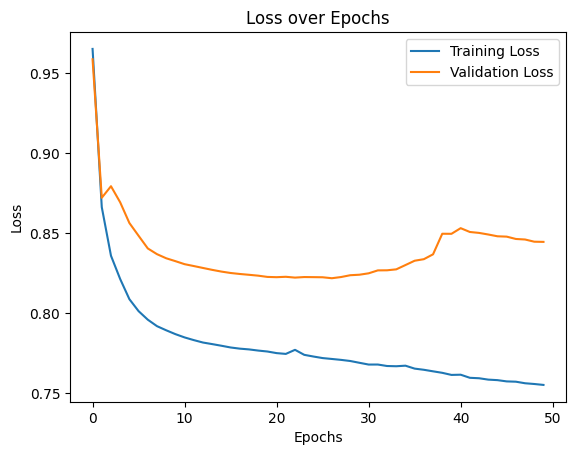

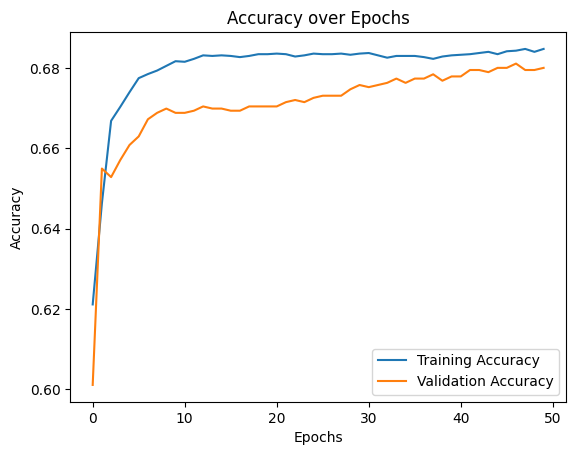

59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.8811 - loss: 0.5503
Validation Loss: 0.8445273637771606, Validation Accuracy: 0.6800000071525574
59/59 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


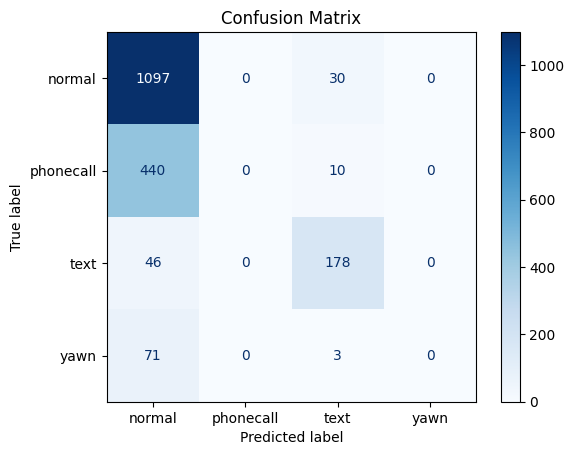


Classification Report:
              precision    recall  f1-score   support

      normal       0.66      0.97      0.79      1127
   phonecall       0.00      0.00      0.00       450
        text       0.81      0.79      0.80       224
        yawn       0.00      0.00      0.00        74

    accuracy                           0.68      1875
   macro avg       0.37      0.44      0.40      1875
weighted avg       0.49      0.68      0.57      1875

Misclassified data saved successfully.

Visualizing Non-Text as Text Data:


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


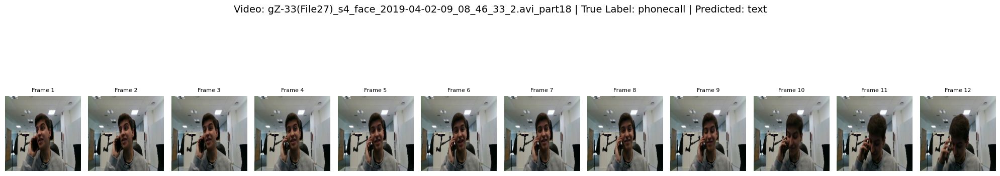

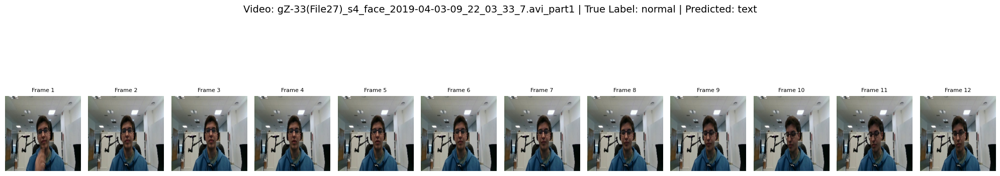

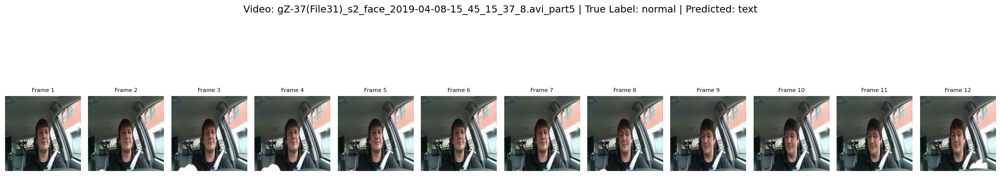

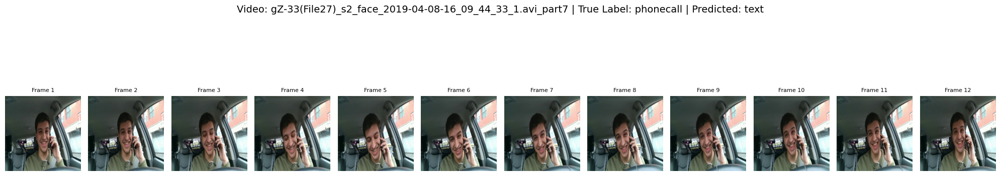

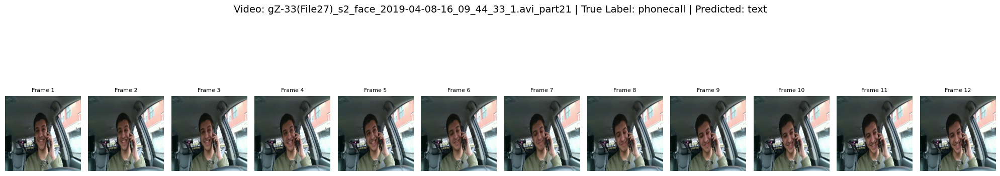


Visualizing Text as Other Data:


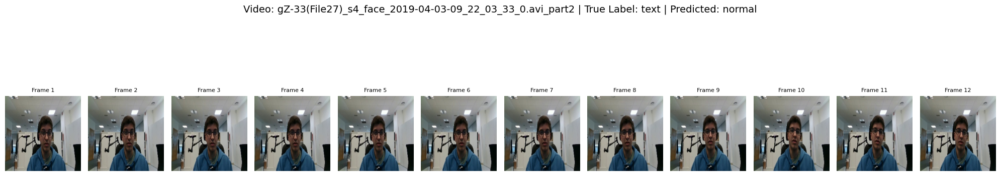

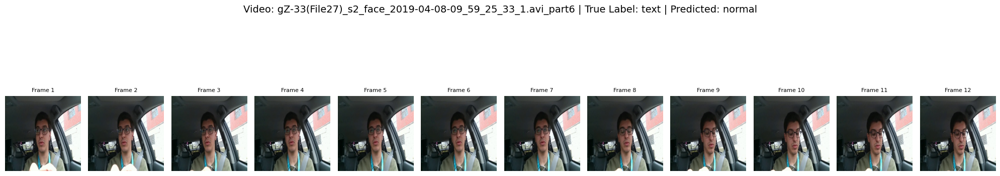

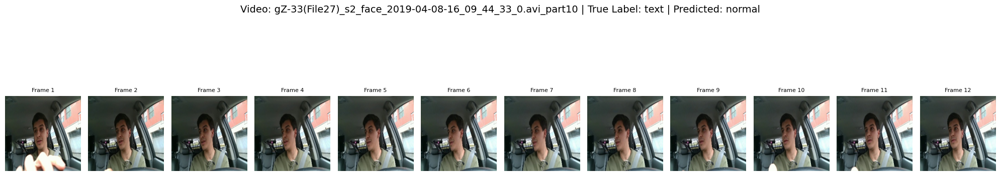

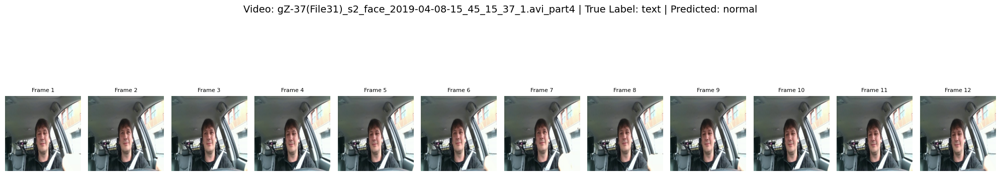

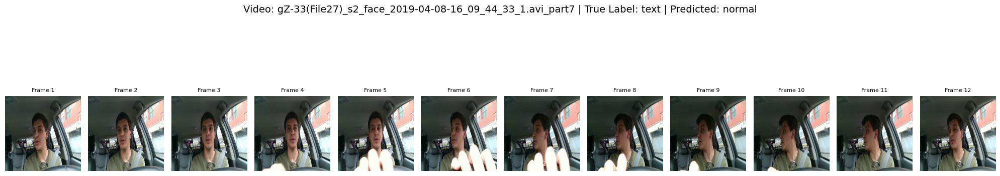

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.utils import to_categorical
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report

train_data = train_data_origin.copy()
validation_data = validation_data_origin.copy()

# Step 1: Label Encoding (label을 숫자로 변환)
label_encoder = LabelEncoder()
train_data.loc[:, 'label_encoded'] = label_encoder.fit_transform(train_data['label'])
validation_data.loc[:, 'label_encoded'] = label_encoder.transform(validation_data['label'])  # 동일한 인코딩 사용
num_classes = len(label_encoder.classes_)  # 라벨 클래스 수

# Step 2: 전체 데이터 정규화 (Yaw만 사용)
def normalize_data(train_data, validation_data):
    """
    전체 데이터를 기준으로 yaw 값을 정규화합니다.
    """
    scaler = MinMaxScaler()

    # Train 데이터 정규화
    train_data.loc[:, ['yaw']] = scaler.fit_transform(train_data[['yaw']])

    # Validation 데이터 정규화 (Train 스케일러 사용)
    validation_data.loc[:, ['yaw']] = scaler.transform(validation_data[['yaw']])

    return train_data, validation_data, scaler

# Train/Validation 데이터 정규화
norm_train_df, norm_val_df, scaler = normalize_data(train_data, validation_data)

# Step 3: 클립별 시계열 데이터 생성 (Yaw만 사용)
def create_video_sequences(data, seq_length=12):
    """
    각 video_name 그룹별로 시계열 데이터를 생성합니다.
    """
    sequences = []
    labels = []

    for (label, video_name), group in data.groupby(['label', 'video_name']):
        group = group.sort_values(by='frame')  # 프레임 순서대로 정렬
        yaw_data = group[['yaw']].values  # Yaw 값만 사용
        label_encoded = group['label_encoded'].iloc[0]  # 해당 비디오의 라벨 (모든 프레임 동일)

        if len(yaw_data) >= seq_length:  # 시퀀스 길이 이상인 경우만 처리
            sequences.append(yaw_data[:seq_length])  # 첫 seq_length 프레임만 사용
            labels.append(label_encoded)

    return np.array(sequences), np.array(labels)

seq_length = 12  # 시퀀스 길이 (프레임 수)
X_train, y_train = create_video_sequences(norm_train_df, seq_length)
X_val, y_val = create_video_sequences(norm_val_df, seq_length)

# Step 4: 라벨을 One-Hot Encoding으로 변환
y_train_one_hot = to_categorical(y_train, num_classes=num_classes)
y_val_one_hot = to_categorical(y_val, num_classes=num_classes)

# Step 5: LSTM 모델 정의 (Yaw만 입력으로 사용)
model = Sequential([
    LSTM(64, activation='relu', input_shape=(seq_length, 1), return_sequences=True),  # 입력 차원 수정: (seq_length, 1)
    LSTM(64, activation='relu'),
    Dense(num_classes, activation='softmax')  # 클래스 수만큼 출력 (라벨 예측)
])

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Step 6: 모델 학습
history = model.fit(X_train, y_train_one_hot, epochs=50, batch_size=32, validation_data=(X_val, y_val_one_hot))

# Step 7: 학습 결과 시각화
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.legend()
plt.title('Loss over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.show()

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.legend()
plt.title('Accuracy over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.show()

# Step 8: 테스트 데이터 평가
test_loss, test_accuracy = model.evaluate(X_val, y_val_one_hot)
print(f"Validation Loss: {test_loss}, Validation Accuracy: {test_accuracy}")

# Step 9: 예측 결과 확인 및 혼동 행렬 시각화
predictions = model.predict(X_val)
predicted_labels = np.argmax(predictions, axis=1)  # 예측된 라벨 (숫자형)
true_labels = np.argmax(y_val_one_hot, axis=1)     # 실제 라벨 (숫자형)

cm = confusion_matrix(true_labels, predicted_labels)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_encoder.classes_)
disp.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix")
plt.show()

# Classification Report 출력 (전체 요약)
print("\nClassification Report:")
print(classification_report(true_labels, predicted_labels, target_names=label_encoder.classes_))

# Step 10: 잘못된 예측 데이터 저장

# 잘못 예측한 결과 저장 및 시각화
process_and_visualize_misclassified_data(
    true_labels=true_labels,
    predicted_labels=predicted_labels,
    y_val=y_val,
    norm_val_df=norm_val_df,
    label_encoder=label_encoder,
    seq_length=12,
    results_path=results_path,
    file_name='yaw',
    image_base_dir=image_base_dir,
    num_samples=5
)

## yaw delta

Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


215/215 ━━━━━━━━━━━━━━━━━━━━ 10s 27ms/step - accuracy: 0.6120 - loss: 1.1093 - val_accuracy: 0.6347 - val_loss: 0.9297
Epoch 2/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - accuracy: 0.6496 - loss: 0.9256 - val_accuracy: 0.6443 - val_loss: 0.9149
Epoch 3/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - accuracy: 0.6602 - loss: 0.8946 - val_accuracy: 0.6549 - val_loss: 0.8754
Epoch 4/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 6s 23ms/step - accuracy: 0.6651 - loss: 0.8801 - val_accuracy: 0.6608 - val_loss: 0.8637
Epoch 5/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - accuracy: 0.6701 - loss: 0.8693 - val_accuracy: 0.6667 - val_loss: 0.8462
Epoch 6/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - accuracy: 0.6761 - loss: 0.8553 - val_accuracy: 0.6720 - val_loss: 0.8364
Epoch 7/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 5s 20ms/step - accuracy: 0.6781 - loss: 0.8484 - val_accuracy: 0.6736 - val_loss: 0.8322
Epoch 8/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - accuracy: 0.6785 - loss: 0.8454 - val_accuracy: 0.67

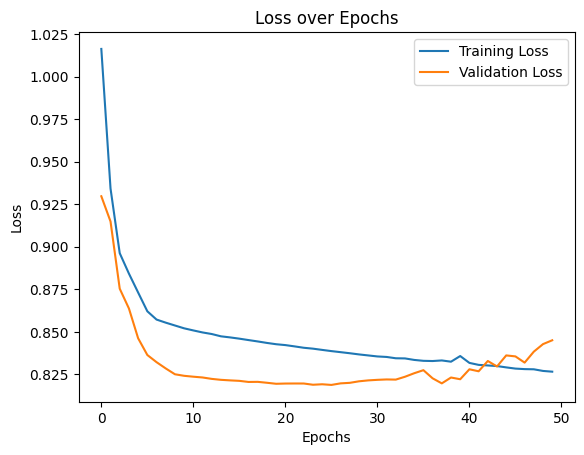

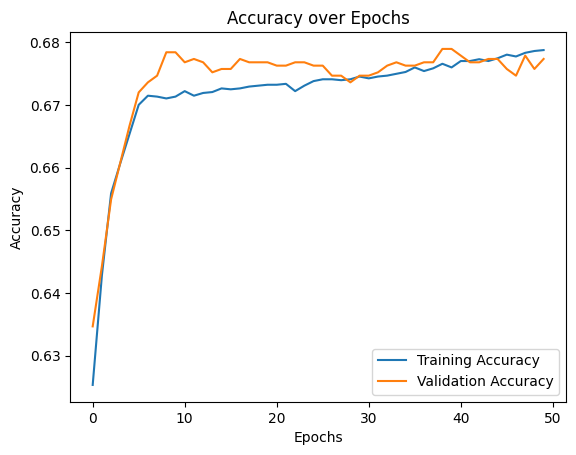

59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.8951 - loss: 0.5482
Validation Loss: 0.8450242280960083, Validation Accuracy: 0.6773333549499512
59/59 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


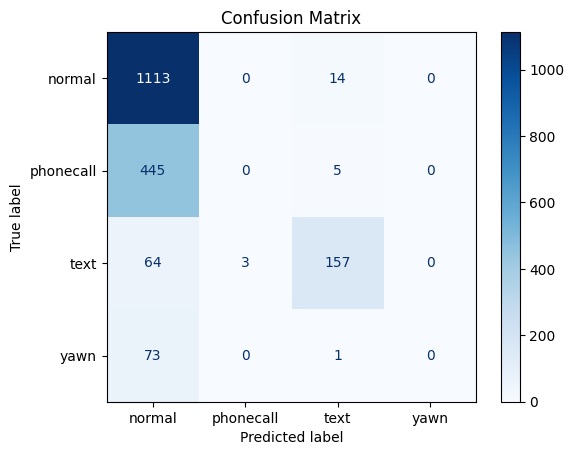


Classification Report:
              precision    recall  f1-score   support

      normal       0.66      0.99      0.79      1127
   phonecall       0.00      0.00      0.00       450
        text       0.89      0.70      0.78       224
        yawn       0.00      0.00      0.00        74

    accuracy                           0.68      1875
   macro avg       0.39      0.42      0.39      1875
weighted avg       0.50      0.68      0.57      1875

Misclassified data saved successfully.

Visualizing Non-Text as Text Data:


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


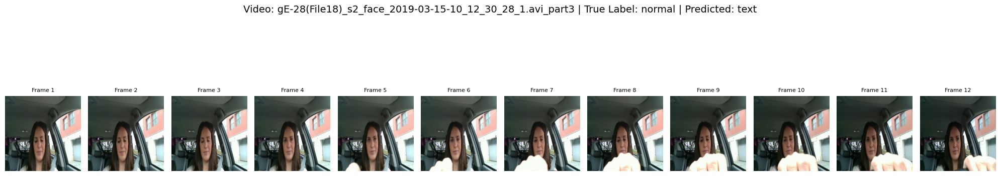

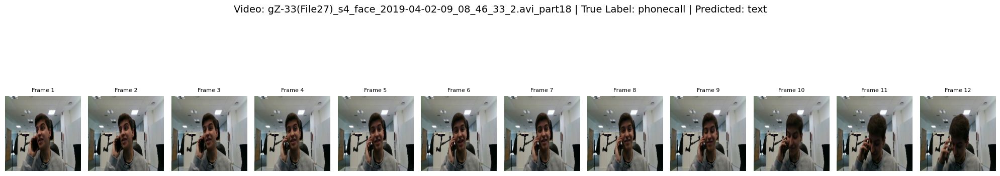

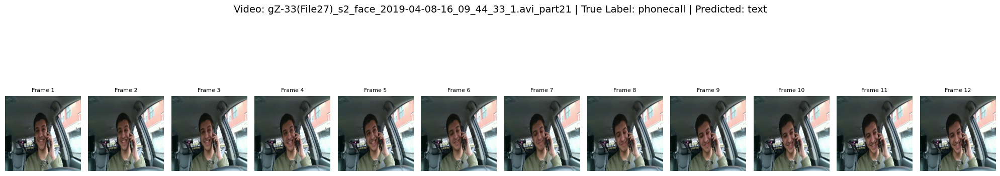

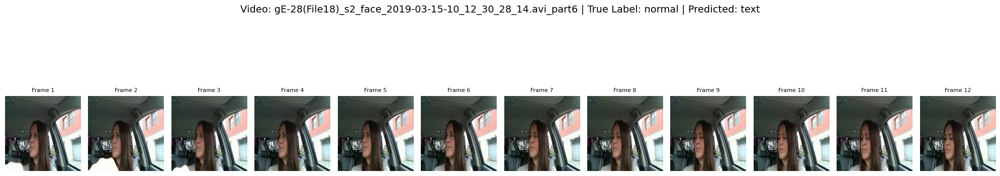

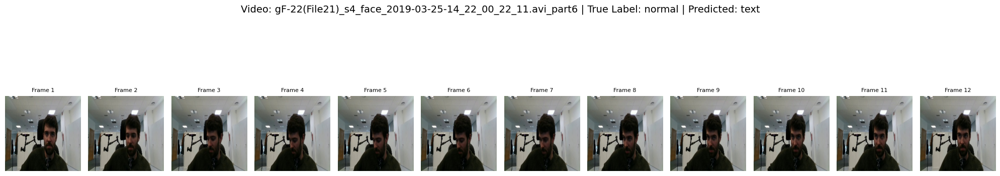


Visualizing Text as Other Data:


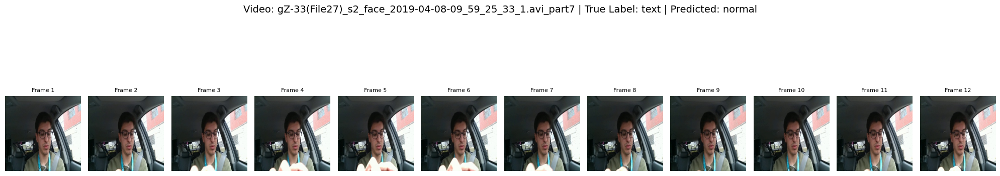

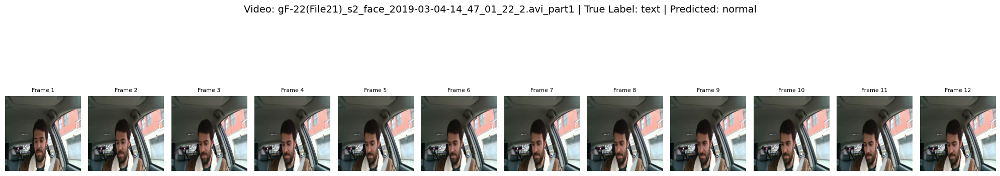

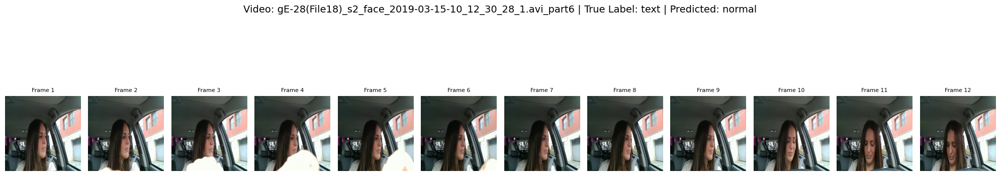

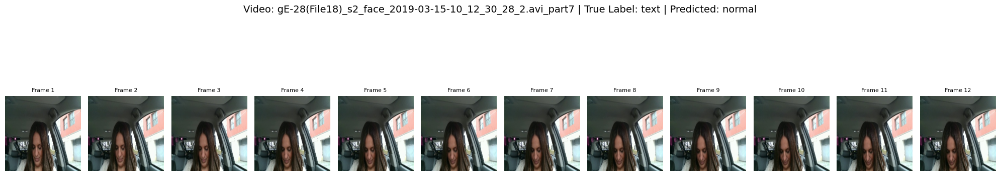

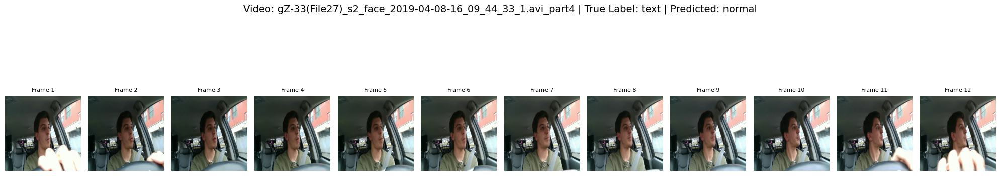

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.utils import to_categorical
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report

train_data = train_data_origin.copy()
validation_data = validation_data_origin.copy()

# Step 1: Label Encoding (label을 숫자로 변환)
label_encoder = LabelEncoder()
train_data['label_encoded'] = label_encoder.fit_transform(train_data['label'])
validation_data['label_encoded'] = label_encoder.transform(validation_data['label'])  # 동일한 인코딩 사용
num_classes = len(label_encoder.classes_)  # 라벨 클래스 수

# Step 2: 전체 데이터 정규화 (Yaw만 사용)
def normalize_data(train_data, validation_data):
    """
    전체 데이터를 기준으로 yaw 값을 정규화합니다.
    """
    scaler = MinMaxScaler()

    # Train 데이터 정규화
    train_data.loc[:, ['yaw']] = scaler.fit_transform(train_data[['yaw']])

    # Validation 데이터 정규화 (Train 스케일러 사용)
    validation_data.loc[:, ['yaw']] = scaler.transform(validation_data[['yaw']])

    return train_data, validation_data, scaler

# Train/Validation 데이터 정규화
norm_train_df, norm_val_df, scaler = normalize_data(train_data, validation_data)

# Step 3: yaw_delta 계산 (프레임 간 변화량)
def calculate_yaw_delta(data):
    """
    각 video_name 그룹별로 yaw의 변화량(delta)을 계산합니다.
    """
    data['yaw_delta'] = data.groupby(['label', 'video_name'])['yaw'].diff().fillna(0)  # 첫 번째 값은 0으로 채움
    return data

norm_train_df = calculate_yaw_delta(norm_train_df)
norm_val_df = calculate_yaw_delta(norm_val_df)

# Step 4: 클립별 시계열 데이터 생성 (Yaw Delta만 사용)
def create_video_sequences(data, seq_length=12):
    """
    각 video_name 그룹별로 시계열 데이터를 생성합니다.
    """
    sequences = []
    labels = []

    for (label, video_name), group in data.groupby(['label', 'video_name']):
        group = group.sort_values(by='frame')  # 프레임 순서대로 정렬
        yaw_delta_data = group[['yaw_delta']].values  # Yaw Delta 값만 사용
        label_encoded = group['label_encoded'].iloc[0]  # 해당 비디오의 라벨 (모든 프레임 동일)

        if len(yaw_delta_data) >= seq_length:  # 시퀀스 길이 이상인 경우만 처리
            sequences.append(yaw_delta_data[-seq_length:])  # 마지막 seq_length 프레임만 사용 (첫번째 프레임의 값이 0이라서)
            labels.append(label_encoded)

    return np.array(sequences), np.array(labels)

seq_length = 11  # 시퀀스 길이 (프레임 수)
X_train, y_train = create_video_sequences(norm_train_df, seq_length)
X_val, y_val = create_video_sequences(norm_val_df, seq_length)

# Step 5: 라벨을 One-Hot Encoding으로 변환
y_train_one_hot = to_categorical(y_train, num_classes=num_classes)
y_val_one_hot = to_categorical(y_val, num_classes=num_classes)

# Step 6: LSTM 모델 정의 (Yaw Delta만 입력으로 사용)
model = Sequential([
    LSTM(64, activation='relu', input_shape=(seq_length, 1), return_sequences=True),
    LSTM(64, activation='relu'),
    Dense(num_classes, activation='softmax')  # 클래스 수만큼 출력 (라벨 예측)
])

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Step 7: 모델 학습
history = model.fit(X_train, y_train_one_hot, epochs=50, batch_size=32, validation_data=(X_val, y_val_one_hot))

# Step 8: 학습 결과 시각화
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.legend()
plt.title('Loss over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.show()

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.legend()
plt.title('Accuracy over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.show()

# Step 9: 테스트 데이터 평가
test_loss, test_accuracy = model.evaluate(X_val, y_val_one_hot)
print(f"Validation Loss: {test_loss}, Validation Accuracy: {test_accuracy}")

# Step 10: 예측 결과 확인 및 혼동 행렬 시각화
predictions = model.predict(X_val)
predicted_labels = np.argmax(predictions, axis=1)  # 예측된 라벨 (숫자형)
true_labels = np.argmax(y_val_one_hot, axis=1)     # 실제 라벨 (숫자형)

cm = confusion_matrix(true_labels, predicted_labels)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_encoder.classes_)
disp.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix")
plt.show()

# Classification Report 출력 (전체 요약)
print("\nClassification Report:")
print(classification_report(true_labels, predicted_labels, target_names=label_encoder.classes_))


# 잘못 예측한 결과 저장 및 시각화
process_and_visualize_misclassified_data(
    true_labels=true_labels,
    predicted_labels=predicted_labels,
    y_val=y_val,
    norm_val_df=norm_val_df,
    label_encoder=label_encoder,
    seq_length=12,
    results_path=results_path,
    file_name='yaw_delta',
    image_base_dir=image_base_dir,
    num_samples=5
)

## yaw, pitch delta

Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


215/215 ━━━━━━━━━━━━━━━━━━━━ 9s 21ms/step - accuracy: 0.6144 - loss: 1.1153 - val_accuracy: 0.6011 - val_loss: 0.9900
Epoch 2/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - accuracy: 0.6397 - loss: 0.9371 - val_accuracy: 0.6443 - val_loss: 0.9049
Epoch 3/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 5s 24ms/step - accuracy: 0.6607 - loss: 0.8918 - val_accuracy: 0.6565 - val_loss: 0.8685
Epoch 4/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step - accuracy: 0.6700 - loss: 0.8683 - val_accuracy: 0.6656 - val_loss: 0.8455
Epoch 5/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - accuracy: 0.6747 - loss: 0.8533 - val_accuracy: 0.6688 - val_loss: 0.8368
Epoch 6/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 6s 21ms/step - accuracy: 0.6791 - loss: 0.8435 - val_accuracy: 0.6709 - val_loss: 0.8312
Epoch 7/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - accuracy: 0.6811 - loss: 0.8386 - val_accuracy: 0.6725 - val_loss: 0.8319
Epoch 8/50
215/215 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - accuracy: 0.6822 - loss: 0.8360 - val_accuracy: 0.673

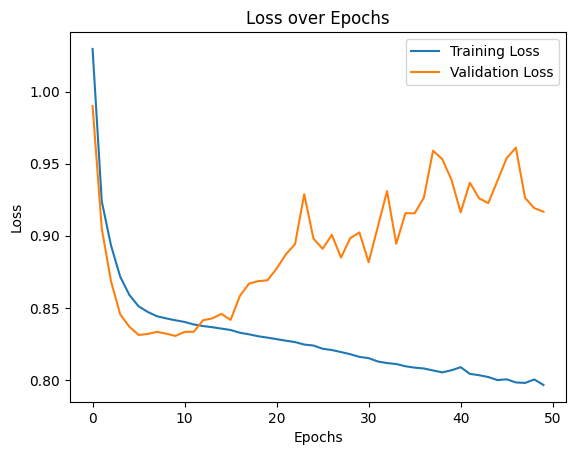

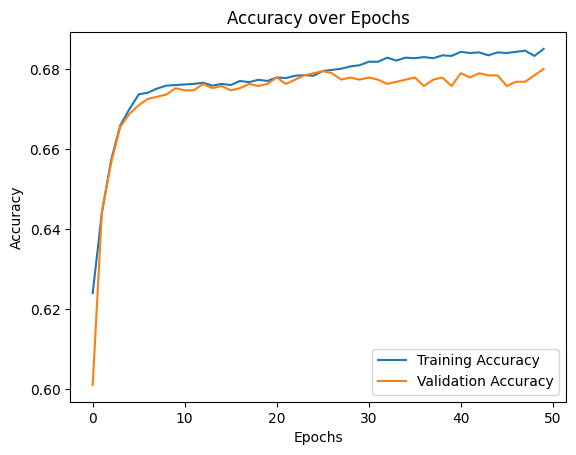

59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.8863 - loss: 0.5447
Validation Loss: 0.916663646697998, Validation Accuracy: 0.6800000071525574
59/59 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


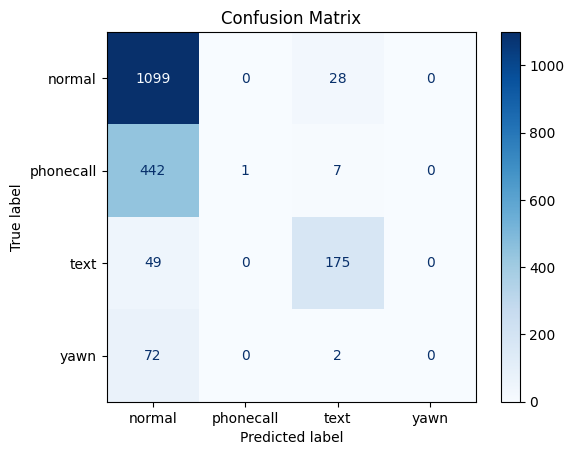


Classification Report:
              precision    recall  f1-score   support

      normal       0.66      0.98      0.79      1127
   phonecall       1.00      0.00      0.00       450
        text       0.83      0.78      0.80       224
        yawn       0.00      0.00      0.00        74

    accuracy                           0.68      1875
   macro avg       0.62      0.44      0.40      1875
weighted avg       0.74      0.68      0.57      1875

Misclassified data saved successfully.

Visualizing Non-Text as Text Data:


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


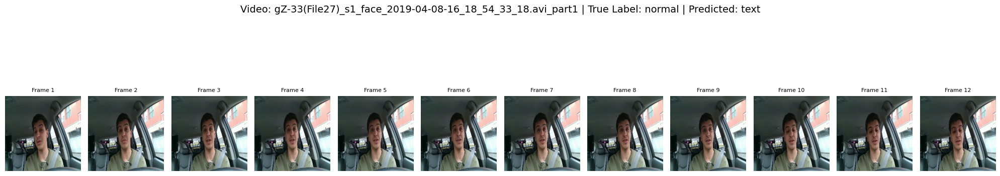

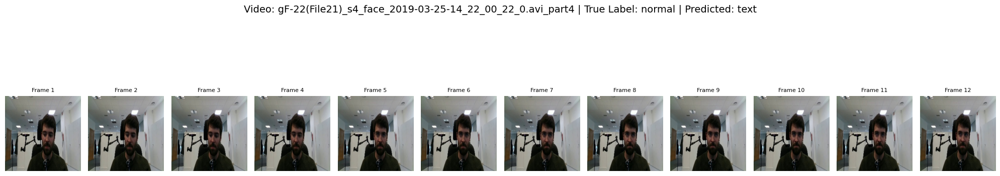

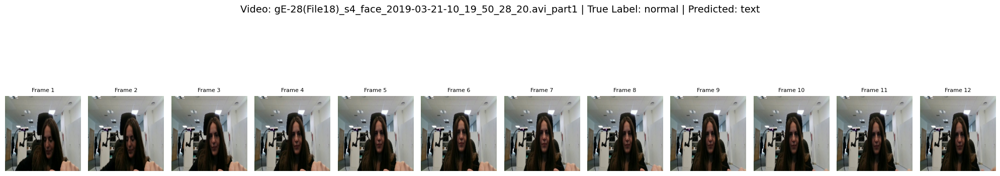

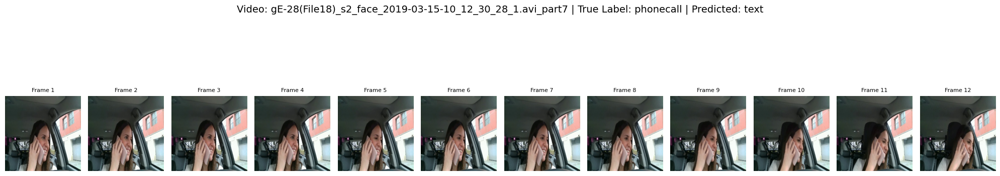

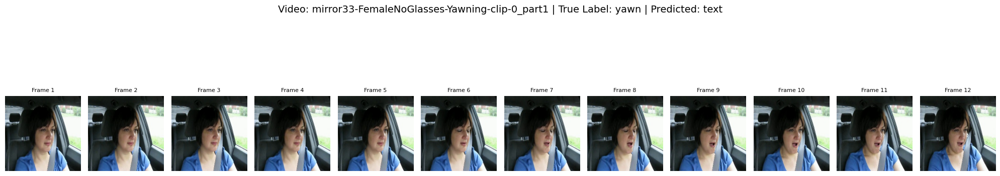


Visualizing Text as Other Data:


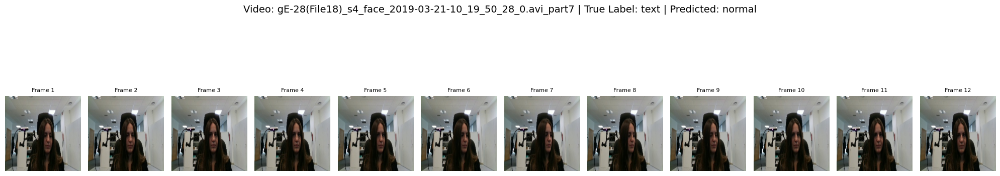

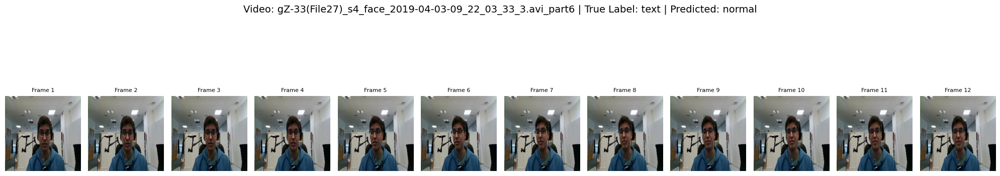

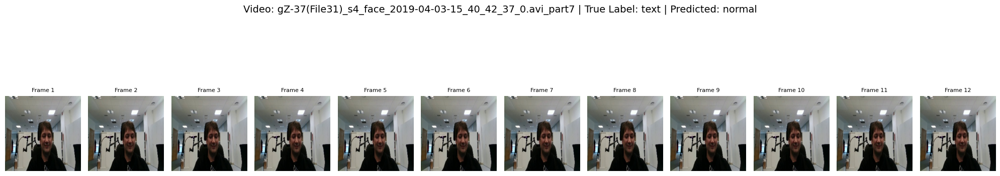

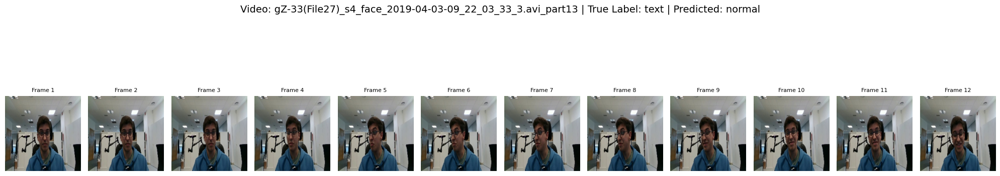

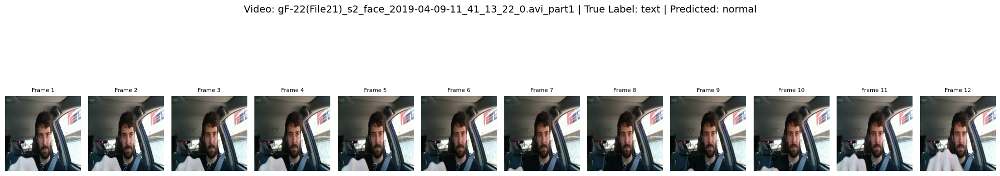

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.utils import to_categorical
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report

train_data = train_data_origin.copy()
validation_data = validation_data_origin.copy()

# Step 1: Label Encoding (label을 숫자로 변환)
label_encoder = LabelEncoder()
train_data['label_encoded'] = label_encoder.fit_transform(train_data['label'])
validation_data['label_encoded'] = label_encoder.transform(validation_data['label'])  # 동일한 인코딩 사용
num_classes = len(label_encoder.classes_)  # 라벨 클래스 수

# Step 2: 전체 데이터 정규화 (Yaw와 Pitch 사용)
def normalize_data(train_data, validation_data):
    """
    전체 데이터를 기준으로 yaw와 pitch 값을 정규화합니다.
    """
    scaler = MinMaxScaler()

    # Train 데이터 정규화
    train_data.loc[:, ['yaw', 'pitch']] = scaler.fit_transform(train_data[['yaw', 'pitch']])

    # Validation 데이터 정규화 (Train 스케일러 사용)
    validation_data.loc[:, ['yaw', 'pitch']] = scaler.transform(validation_data[['yaw', 'pitch']])

    return train_data, validation_data, scaler

# Train/Validation 데이터 정규화
norm_train_df, norm_val_df, scaler = normalize_data(train_data, validation_data)

# Step 3: yaw_delta와 pitch_delta 계산 (프레임 간 변화량)
def calculate_deltas(data):
    """
    각 video_name 그룹별로 yaw와 pitch의 변화량(delta)을 계산합니다.
    """
    data['yaw_delta'] = data.groupby(['label', 'video_name'])['yaw'].diff().fillna(0)  # 첫 번째 값은 0으로 채움
    data['pitch_delta'] = data.groupby(['label', 'video_name'])['pitch'].diff().fillna(0)  # 첫 번째 값은 0으로 채움
    return data

norm_train_df = calculate_deltas(norm_train_df)
norm_val_df = calculate_deltas(norm_val_df)

# Step 4: 클립별 시계열 데이터 생성 (Yaw Delta와 Pitch Delta 사용)
def create_video_sequences(data, seq_length=12):
    """
    각 video_name 그룹별로 시계열 데이터를 생성합니다.
    """
    sequences = []
    labels = []

    for (label, video_name), group in data.groupby(['label', 'video_name']):
        group = group.sort_values(by='frame')  # 프레임 순서대로 정렬
        delta_data = group[['yaw_delta', 'pitch_delta']].values  # Yaw Delta와 Pitch Delta 값만 사용
        label_encoded = group['label_encoded'].iloc[0]  # 해당 비디오의 라벨 (모든 프레임 동일)

        if len(delta_data) >= seq_length:  # 시퀀스 길이 이상인 경우만 처리
            sequences.append(delta_data[-seq_length:])  # 마지막 seq_length 프레임만 사용 (첫번째 프레임의 값이 0이라서)
            labels.append(label_encoded)

    return np.array(sequences), np.array(labels)

seq_length = 11  # 시퀀스 길이 (프레임 수)
X_train, y_train = create_video_sequences(norm_train_df, seq_length)
X_val, y_val = create_video_sequences(norm_val_df, seq_length)

# Step 5: 라벨을 One-Hot Encoding으로 변환
y_train_one_hot = to_categorical(y_train, num_classes=num_classes)
y_val_one_hot = to_categorical(y_val, num_classes=num_classes)

# Step 6: LSTM 모델 정의 (Yaw Delta와 Pitch Delta 입력으로 사용)
model = Sequential([
    LSTM(64, activation='relu', input_shape=(seq_length, 2), return_sequences=True),  # 입력 차원 수정: (seq_length, 2)
    LSTM(64, activation='relu'),
    Dense(num_classes, activation='softmax')  # 클래스 수만큼 출력 (라벨 예측)
])

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Step 7: 모델 학습
history = model.fit(X_train, y_train_one_hot, epochs=50, batch_size=32, validation_data=(X_val, y_val_one_hot))

# Step 8: 학습 결과 시각화
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.legend()
plt.title('Loss over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.show()

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.legend()
plt.title('Accuracy over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.show()

# Step 9: 테스트 데이터 평가
test_loss, test_accuracy = model.evaluate(X_val, y_val_one_hot)
print(f"Validation Loss: {test_loss}, Validation Accuracy: {test_accuracy}")

# Step 10: 예측 결과 확인 및 혼동 행렬 시각화
predictions = model.predict(X_val)
predicted_labels = np.argmax(predictions, axis=1)  # 예측된 라벨 (숫자형)
true_labels = np.argmax(y_val_one_hot, axis=1)     # 실제 라벨 (숫자형)

cm = confusion_matrix(true_labels, predicted_labels)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_encoder.classes_)
disp.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix")
plt.show()

# Classification Report 출력 (전체 요약)
print("\nClassification Report:")
print(classification_report(true_labels, predicted_labels, target_names=label_encoder.classes_))

# 잘못 예측한 결과 저장 및 시각화
process_and_visualize_misclassified_data(
    true_labels=true_labels,
    predicted_labels=predicted_labels,
    y_val=y_val,
    norm_val_df=norm_val_df,
    label_encoder=label_encoder,
    seq_length=12,
    results_path=results_path,
    file_name='yaw_pitch_delta',
    image_base_dir=image_base_dir,
    num_samples=5
)
